# Estimating the Learning Coefficients (RLCTs)

In [ ]:
! pip install devinterp

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.2/42.2 kB 2.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 138.3/138.3 kB 3.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 93.7/93.7 kB 7.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 215.0/215.0 kB 10.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.6/11.6 MB 31.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 370.9/370.9 kB 8.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.9/1.9 MB 13.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 325.1/325.1 kB 21.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 36.4/36.4 MB 13.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 619.9/619.9 MB 2.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 77.1/77.1 kB 11.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.3/2.3 MB 47.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━

In [ ]:
import torch
import numpy as np
import seaborn
import yaml
import devinterp
import torch.nn as nn
import torchvision
import pandas as pd
import matplotlib.pyplot as plt
from torch import optim
from tqdm import tqdm
from torchvision import datasets, transforms
from torch.utils.data import DataLoader
from devinterp.slt import estimate_learning_coeff, estimate_learning_coeff_with_summary
from devinterp.optim.sgld import SGLD
from devinterp.utils import plot_trace

/usr/local/lib/python3.10/dist-packages/torchvision/io/image.py:13: UserWarning: Failed to load image Python extension: '/usr/local/lib/python3.10/dist-packages/torchvision/image.so: undefined symbol: _ZN3c104cuda9SetDeviceEi'If you don't plan on using image functionality from `torchvision.io`, you can ignore this warning. Otherwise, there might be something wrong with your environment. Did you have `libjpeg` or `libpng` installed before building `torchvision` from source?
  warn(


In [ ]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
device

'cuda'

In [ ]:
on_colab = True
use_adam_op = True
augmented = True
use_label_noise = True
pytorch_default_resnet = True
model_width = 64
num_classes = 10
frac_label_noise = 0.15
mean_value = 0.5
std_value = 0.5
batch_size = 1000 #128
lr = 0.0001
epochs = 1500
model_seed = 42
data_seed = 42

NUM_CHAINS = 10
NUM_DRAWS = 1000

In [ ]:
plt.rcParams["figure.figsize"]=15,12  # note: this cell may need to be re-run after creating a plot to take effect

In [ ]:
if on_colab == True:
  from google.colab import drive
  drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
checkpoints_path = '/content/gdrive/My Drive/checkpoints/'
checkpoints_per_path = '/content/gdrive/My Drive/checkpoints_per/'
rlcts_path = '/content/gdrive/My Drive/checkpoints/rlcts/'

In [ ]:
# Let's also import the standard resnet from PyTorch
resnet_pytorch = torch.hub.load('pytorch/vision:v0.10.0', 'resnet18', pretrained=False)

Downloading: "https://github.com/pytorch/vision/zipball/v0.10.0" to /root/.cache/torch/hub/v0.10.0.zip
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)


In [ ]:
#We need to put the number of classes in the output layer of the PyTorch layer to macth our number of classes 10
resnet_pytorch.fc = nn.Linear(512, num_classes)

In [ ]:
def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

In [ ]:
print(f"The number of parameters is: {count_parameters(resnet_pytorch)}")

The number of parameters is: 11181642


In [ ]:
## ResNet18 for CIFAR
## Based on: https://gitlab.com/harvard-machine-learning/double-descent/-/blob/master/models/resnet18k.py

class PreActBlock(nn.Module):
    '''Pre-activation version of the BasicBlock.'''
    expansion = 1

    def __init__(self, in_planes, planes, stride=1, **kwargs):
        super(PreActBlock, self).__init__()
        self.bn1 = nn.BatchNorm2d(in_planes)
        self.conv1 = nn.Conv2d(
            in_planes, planes, kernel_size=3, stride=stride, padding=1, bias=False)
        self.bn2 = nn.BatchNorm2d(planes)
        self.conv2 = nn.Conv2d(planes, planes, kernel_size=3,
                               stride=1, padding=1, bias=False)

        if stride != 1 or in_planes != self.expansion*planes:
            self.shortcut = nn.Sequential(
                nn.Conv2d(in_planes, self.expansion*planes,
                          kernel_size=1, stride=stride, bias=False)
            )

    def forward(self, x):
        out = F.relu(self.bn1(x))
        shortcut = self.shortcut(out) if hasattr(self, 'shortcut') else x
        out = self.conv1(out)
        out = self.conv2(F.relu(self.bn2(out)))
        out += shortcut
        return out

class PreActResNet(nn.Module):
    def __init__(self, block, num_blocks, num_classes=10, init_channels=64):
        super(PreActResNet, self).__init__()
        self.in_planes = init_channels
        c = init_channels

        self.conv1 = nn.Conv2d(3, c, kernel_size=3,
                               stride=1, padding=1, bias=False)
        self.layer1 = self._make_layer(block, c, num_blocks[0], stride=1)
        self.layer2 = self._make_layer(block, 2*c, num_blocks[1], stride=2)
        self.layer3 = self._make_layer(block, 4*c, num_blocks[2], stride=2)
        self.layer4 = self._make_layer(block, 8*c, num_blocks[3], stride=2)
        self.linear = nn.Linear(8*c*block.expansion, num_classes)

    def _make_layer(self, block, planes, num_blocks, stride):
        # eg: [2, 1, 1, ..., 1]. Only the first one downsamples.
        strides = [stride] + [1]*(num_blocks-1)
        layers = []
        for stride in strides:
            layers.append(block(self.in_planes, planes, stride))
            self.in_planes = planes * block.expansion
        return nn.Sequential(*layers)

    def forward(self, x):
        out = self.conv1(x)
        out = self.layer1(out)
        out = self.layer2(out)
        out = self.layer3(out)
        out = self.layer4(out)
        out = F.avg_pool2d(out, 4)
        out = out.view(out.size(0), -1)
        out = self.linear(out)
        return out

def make_resnet18k(k, num_classes) -> PreActResNet:
    ''' Returns a ResNet18 with width parameter k. (k=64 is standard ResNet18)'''
    return PreActResNet(PreActBlock, [2, 2, 2, 2], num_classes=num_classes, init_channels=k)

In [ ]:
if model_seed is not None:
    torch.manual_seed(model_seed)

resnet = make_resnet18k(model_width, num_classes)
resnet.to(device)

print(f"The number of parameters is: {count_parameters(resnet)}")

The number of parameters is: 11171146


In [ ]:
# Let's import the CIFAR10 dataset from torchvision
transform = transforms.Compose([transforms.ToTensor()]) if not augmented else transforms.Compose([transforms.ToTensor(), transforms.RandomCrop(32, padding=4), transforms.RandomHorizontalFlip(), transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))])

if data_seed is not None:
    torch.manual_seed(data_seed)

train_set = datasets.CIFAR10(root='./data',
                             train=True,
                             download=True,
                             transform=transform
                             )

trainloader = DataLoader(train_set,
                         batch_size=batch_size,
                         shuffle=True
                         )

test_set = datasets.CIFAR10(root='./data',
                            train=False,
                            download=True,
                            transform=transform)

testloader = DataLoader(test_set,
                        shuffle=False,
                        batch_size=batch_size
                        )

100%|██████████| 170498071/170498071 [00:01<00:00, 104959726.66it/s]


Extracting ./data/cifar-10-python.tar.gz to ./data
Files already downloaded and verified


In [ ]:
np.random.seed(data_seed)
num_noise = int(frac_label_noise * len(trainloader.dataset.data))
true_targets = trainloader.dataset.targets

labels = torch.from_numpy(np.array(true_targets)).clone()
corrupt_indices = np.random.permutation(len(true_targets))[:num_noise]
check_labels = labels[corrupt_indices].tolist() # I will use this to cross-chec
labels, corrupt_indices, labels[corrupt_indices], check_labels, np.unique(labels[corrupt_indices].tolist(), return_counts=True)

(tensor([6, 9, 9,  ..., 9, 1, 1]),
 array([33553,  9427,   199, ...,  6166, 35101,  3594]),
 tensor([7, 8, 0,  ..., 8, 3, 3]),
 [7,
  8,
  0,
  6,
  1,
  6,
  8,
  0,
  6,
  5,
  2,
  5,
  0,
  7,
  1,
  6,
  5,
  6,
  6,
  5,
  0,
  5,
  7,
  2,
  4,
  4,
  5,
  5,
  4,
  8,
  4,
  3,
  5,
  0,
  0,
  8,
  0,
  1,
  8,
  0,
  3,
  0,
  0,
  0,
  9,
  4,
  4,
  6,
  7,
  6,
  9,
  0,
  9,
  9,
  4,
  3,
  6,
  2,
  9,
  9,
  8,
  4,
  4,
  8,
  1,
  1,
  3,
  9,
  1,
  5,
  0,
  3,
  0,
  2,
  2,
  7,
  8,
  3,
  1,
  8,
  7,
  5,
  4,
  0,
  5,
  7,
  8,
  1,
  1,
  4,
  8,
  3,
  2,
  2,
  5,
  9,
  7,
  7,
  8,
  8,
  3,
  4,
  6,
  1,
  7,
  8,
  3,
  7,
  1,
  7,
  6,
  4,
  3,
  0,
  4,
  6,
  0,
  8,
  3,
  3,
  8,
  9,
  6,
  5,
  1,
  4,
  9,
  2,
  4,
  3,
  2,
  4,
  1,
  0,
  1,
  6,
  4,
  2,
  8,
  2,
  7,
  1,
  3,
  6,
  5,
  8,
  8,
  5,
  4,
  6,
  4,
  1,
  3,
  7,
  1,
  7,
  8,
  7,
  1,
  1,
  2,
  5,
  9,
  1,
  9,
  2,
  4,
  5,
  5,
  2,
  2,
  3,
  6,
  3,
  5

In [ ]:
d = pd.read_csv(checkpoints_path + 'fifteen_percent_label_noise.csv')

deranged = d.values
deranged = deranged.squeeze(1)
deranged = deranged.tolist()
print(deranged)

[1, 2, 5, 1, 8, 1, 5, 9, 9, 8, 8, 0, 5, 9, 6, 0, 8, 2, 0, 8, 6, 1, 4, 6, 5, 1, 6, 1, 2, 6, 3, 7, 6, 5, 5, 4, 7, 9, 7, 5, 7, 9, 6, 9, 0, 8, 0, 8, 8, 7, 4, 6, 8, 3, 7, 4, 5, 4, 8, 7, 1, 3, 0, 0, 0, 4, 5, 4, 6, 0, 4, 2, 1, 3, 8, 1, 0, 5, 0, 4, 2, 7, 9, 3, 2, 4, 3, 0, 0, 5, 4, 8, 3, 7, 2, 8, 0, 9, 5, 0, 6, 7, 5, 8, 6, 1, 6, 9, 2, 3, 1, 3, 4, 2, 5, 3, 7, 4, 0, 1, 7, 1, 2, 4, 2, 9, 1, 6, 1, 7, 9, 6, 7, 5, 0, 3, 3, 5, 7, 8, 5, 9, 2, 1, 8, 2, 1, 0, 1, 1, 2, 8, 1, 2, 6, 1, 4, 8, 7, 9, 3, 8, 5, 4, 5, 4, 9, 7, 4, 4, 5, 5, 4, 8, 7, 3, 1, 0, 8, 3, 3, 2, 6, 3, 5, 8, 2, 1, 4, 6, 4, 3, 8, 6, 1, 8, 4, 5, 6, 3, 7, 8, 7, 3, 3, 2, 1, 4, 5, 4, 2, 7, 1, 7, 4, 2, 4, 5, 4, 5, 4, 9, 8, 9, 7, 8, 1, 4, 5, 0, 8, 7, 9, 9, 0, 5, 0, 7, 9, 2, 0, 9, 6, 0, 5, 4, 2, 1, 5, 3, 9, 4, 9, 7, 4, 1, 9, 2, 9, 9, 6, 1, 4, 4, 1, 6, 2, 7, 5, 1, 6, 4, 9, 9, 7, 5, 5, 5, 9, 6, 6, 7, 0, 8, 9, 7, 5, 1, 6, 4, 3, 2, 0, 2, 7, 0, 4, 3, 8, 6, 7, 0, 8, 6, 2, 6, 2, 5, 1, 3, 8, 9, 4, 2, 9, 2, 6, 8, 5, 7, 8, 4, 0, 3, 7, 7, 3, 6, 9, 1, 1, 7, 1, 

In [ ]:
type(deranged)

list

In [ ]:
labels[corrupt_indices] = torch.from_numpy(np.array(deranged))
labels[corrupt_indices]

tensor([1, 2, 5,  ..., 6, 6, 4])

In [ ]:
# Let's change the labels in the initial trainloader with the noisy labels
if use_label_noise:
    trainloader.dataset.targets = labels

In [ ]:
criterion = nn.CrossEntropyLoss()
model = resnet if not pytorch_default_resnet else resnet_pytorch
model.to(device)
optimizer = optim.SGD(model.parameters(), lr, momentum=0.9, weight_decay=5e-10) if not use_adam_op else optim.Adam(model.parameters(), lr)
dl = trainloader #if not use_label_noise else new_dataloader
count_parameters(model) # Cross-checking the model is the right one

11181642

In [ ]:
# For sweep calibration of SGLD
EPSILONS = [1e-5, 1e-4, 1e-3]
GAMMAS = [1, 10, 100]

def estimate_llcs_sweeper(model, epsilons, gammas):
    results = {}
    for epsilon in epsilons:
        for gamma in gammas:
            optim_kwargs = dict(
                lr=epsilon,
                noise_level=1.0,
                elasticity=gamma,
                num_samples=len(train_set),
                temperature="adaptive",
            )
            pair = (epsilon, gamma)
            results[pair] = estimate_learning_coeff_with_summary(
                model=model,
                loader=trainloader,
                criterion=criterion,
                sampling_method=SGLD,
                optimizer_kwargs=optim_kwargs,
                num_chains=NUM_CHAINS,
                num_draws=NUM_DRAWS,
                num_burnin_steps=50,
                device=device,
                online=True,
            )
    return results


def plot_single_graph(result, title=''):
    llc_color = 'teal'
    fig, axs = plt.subplots(1, 1)
    # plot loss traces
    loss_traces = result['loss/trace']
    for trace in loss_traces:
        init_loss = trace[0]
        zeroed_trace = trace - init_loss
        sgld_steps = list(range(len(trace)))
        axs.plot(sgld_steps, zeroed_trace)

    # plot llcs
    means = result['llc/means']
    stds = result['llc/stds']
    sgld_steps = list(range(len(means)))
    axs2 = axs.twinx()
    axs2.plot(sgld_steps, means, color=llc_color, linestyle='--', linewidth=2, label=f'llc', zorder=3)
    axs2.fill_between(sgld_steps, means - stds, means + stds, color=llc_color, alpha=0.3, zorder=2)

    # center zero, assume zero is in the range of both y axes already
    y1_min, y1_max = axs.get_ylim()
    y2_min, y2_max = axs2.get_ylim()
    y1_zero_ratio = abs(y1_min) / (abs(y1_min) + abs(y1_max))
    y2_zero_ratio = abs(y2_min) / (abs(y2_min) + abs(y2_max))
    percent_to_add = abs(y1_zero_ratio - y2_zero_ratio)
    y1_amt_to_add = (y1_max - y1_min) * percent_to_add
    y2_amt_to_add = (y2_max - y2_min) * percent_to_add
    if y1_zero_ratio < y2_zero_ratio:
        # add to bottom of y1 and top of y2
        y1_min -= y1_amt_to_add
        y2_max += y2_amt_to_add
    elif y2_zero_ratio < y1_zero_ratio:
        # add to bottom of y2 and top of y1
        y2_min -= y2_amt_to_add
        y1_max += y1_amt_to_add
    axs.set_ylim(y1_min, y1_max)
    axs2.set_ylim(y2_min, y2_max)
    axs.set_xlabel('SGLD time step')
    axs.set_ylabel('loss')
    axs2.set_ylabel('llc', color=llc_color)
    axs2.tick_params(axis='y', labelcolor=llc_color)
    axs.axhline(color='black', linestyle=':')
    fig.suptitle(title, fontsize=16)
    plt.tight_layout()
    plt.show()


def plot_sweep_single_model(results, epsilons, gammas, **kwargs):
    llc_color = 'teal'
    fig, axs = plt.subplots(len(epsilons), len(gammas))

    for i, epsilon in enumerate(epsilons):
        for j, gamma in enumerate(gammas):
            result = results[(epsilon, gamma)]
            # plot loss traces
            loss_traces = result['loss/trace']
            for trace in loss_traces:
                init_loss = trace[0]
                zeroed_trace = trace - init_loss
                sgld_steps = list(range(len(trace)))
                axs[i, j].plot(sgld_steps, zeroed_trace)

            # plot llcs
            means = result['llc/means']
            stds = result['llc/stds']
            sgld_steps = list(range(len(means)))
            axs2 = axs[i, j].twinx()
            axs2.plot(sgld_steps, means, color=llc_color, linestyle='--', linewidth=2, label=f'llc', zorder=3)
            axs2.fill_between(sgld_steps, means - stds, means + stds, color=llc_color, alpha=0.3, zorder=2)

            # center zero, assume zero is in the range of both y axes already
            y1_min, y1_max = axs[i, j].get_ylim()
            y2_min, y2_max = axs2.get_ylim()
            y1_zero_ratio = abs(y1_min) / (abs(y1_min) + abs(y1_max))
            y2_zero_ratio = abs(y2_min) / (abs(y2_min) + abs(y2_max))
            percent_to_add = abs(y1_zero_ratio - y2_zero_ratio)
            y1_amt_to_add = (y1_max - y1_min) * percent_to_add
            y2_amt_to_add = (y2_max - y2_min) * percent_to_add
            if y1_zero_ratio < y2_zero_ratio:
                # add to bottom of y1 and top of y2
                y1_min -= y1_amt_to_add
                y2_max += y2_amt_to_add
            elif y2_zero_ratio < y1_zero_ratio:
                # add to bottom of y2 and top of y1
                y2_min -= y2_amt_to_add
                y1_max += y1_amt_to_add
            axs[i, j].set_ylim(y1_min, y1_max)
            axs2.set_ylim(y2_min, y2_max)

            axs[i, j].set_title(f"$\epsilon$ = {epsilon} : $\gamma$ = {gamma}")
            # only show x axis label on last row
            if i == len(epsilons) - 1:
                axs[i, j].set_xlabel('SGLD time step')
            axs[i, j].set_ylabel('loss')
            axs2.set_ylabel('llc', color=llc_color)
            axs2.tick_params(axis='y', labelcolor=llc_color)
    if kwargs['title']:
        fig.suptitle(kwargs['title'], fontsize=16)
    plt.tight_layout()
    plt.show()

In [ ]:
# Used to find the optimal values of epsilon and gamma
original_checkpoint = checkpoints_path + 'adam_checkpoint_with_noise'
name = 'sgd_checkpoint' if not use_adam_op else 'adam_checkpoint'

checkpoints = [10] + list(range(100, 1500, 100))
all_results = []

for i in range(len(checkpoints)):

      checkpoint_name = original_checkpoint + str(checkpoints[i]) + '.pth'
      right_name = name + str(checkpoints[i])
      checkpoint = torch.load(checkpoint_name, map_location = device)
      model.load_state_dict(checkpoint['model_state'])

      results = estimate_llcs_sweeper(model, EPSILONS, GAMMAS)

      current_checkpoint = rlcts_path + right_name + '_rlcts.pt' if not use_label_noise else rlcts_path + right_name + '_with_noise' + '_rlcts.pt'
      torch.save(results, current_checkpoint)

      all_results.append(results)

      plot_sweep_single_model(results, EPSILONS, GAMMAS, title='Calibration sweep of ResNet model for lr ($\epsilon$) and elasticity ($\gamma$)')
      plt.show()

In [ ]:
epsilon = 3e-5
gamma = 1
optim_kwargs = dict(
                lr=epsilon,
                noise_level=1.0,
                elasticity=gamma,
                num_samples=len(train_set),
                temperature="adaptive"
                )

Chain 9: 100%|██████████| 1050/1050 [00:54<00:00, 19.24it/s]


Lambda hat estimates for adam_checkpoint10: 
llc-chain/0: 287.7101135253906
llc-chain/1: 355.3468017578125
llc-chain/2: 63.63834762573242
llc-chain/3: 200.298828125
llc-chain/4: 99.43601989746094
llc-chain/5: 216.5521697998047
llc-chain/6: 59.05717849731445
llc-chain/7: 197.29429626464844
llc-chain/8: 135.93663024902344
llc-chain/9: 32.84602355957031
llc/mean: 164.8116455078125
llc/std: 105.58931732177734



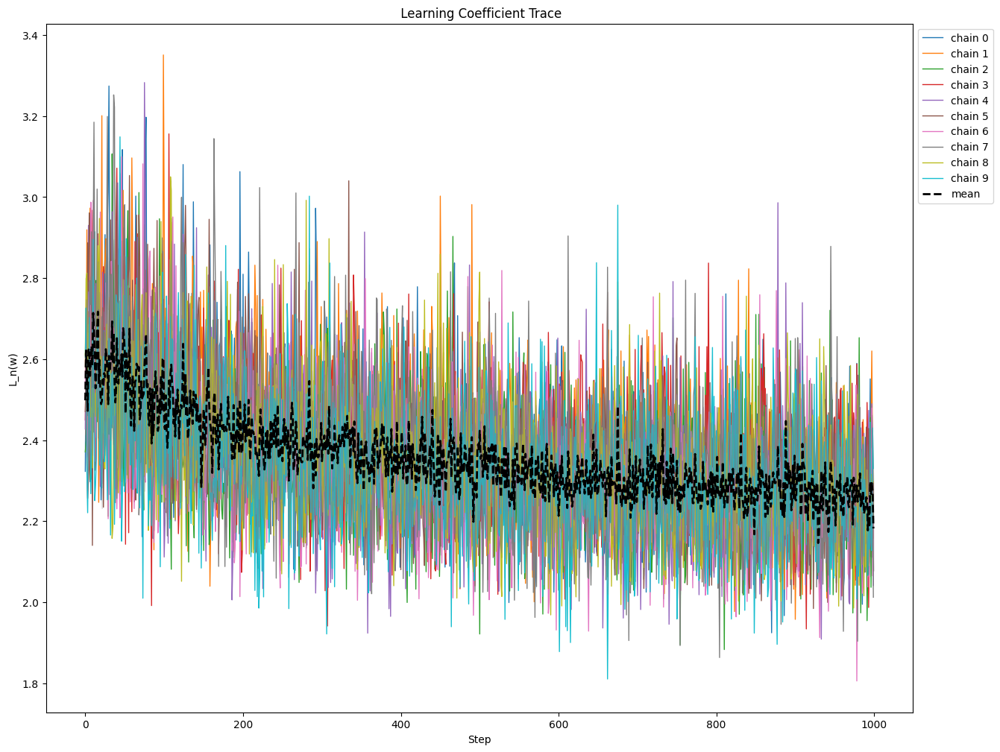

<Figure size 1200x900 with 0 Axes>

Chain 9: 100%|██████████| 1050/1050 [00:57<00:00, 18.35it/s]


Lambda hat estimates for adam_checkpoint100: 
llc-chain/0: 213.58290100097656
llc-chain/1: 251.3846893310547
llc-chain/2: 446.4919738769531
llc-chain/3: 415.7514343261719
llc-chain/4: 442.7823181152344
llc-chain/5: 644.5057373046875
llc-chain/6: 394.25146484375
llc-chain/7: 373.1415100097656
llc-chain/8: 395.13287353515625
llc-chain/9: 239.72134399414062
llc/mean: 381.67462158203125
llc/std: 126.47793579101562



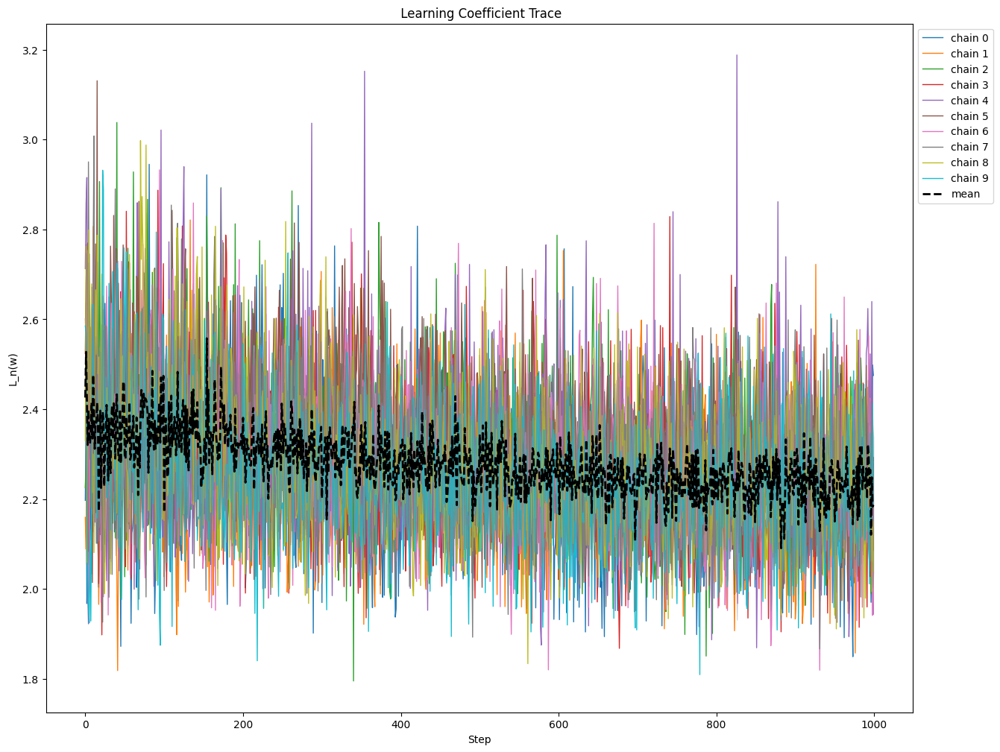

<Figure size 1200x900 with 0 Axes>

Chain 9: 100%|██████████| 1050/1050 [00:57<00:00, 18.12it/s]


Lambda hat estimates for adam_checkpoint200: 
llc-chain/0: -2078.2041015625
llc-chain/1: -2103.00048828125
llc-chain/2: -2036.080078125
llc-chain/3: -2014.73876953125
llc-chain/4: -2029.3438720703125
llc-chain/5: -2106.833740234375
llc-chain/6: -2023.73583984375
llc-chain/7: -2119.08642578125
llc-chain/8: -1983.7073974609375
llc-chain/9: -2032.2877197265625
llc/mean: -2052.701904296875
llc/std: 45.700191497802734



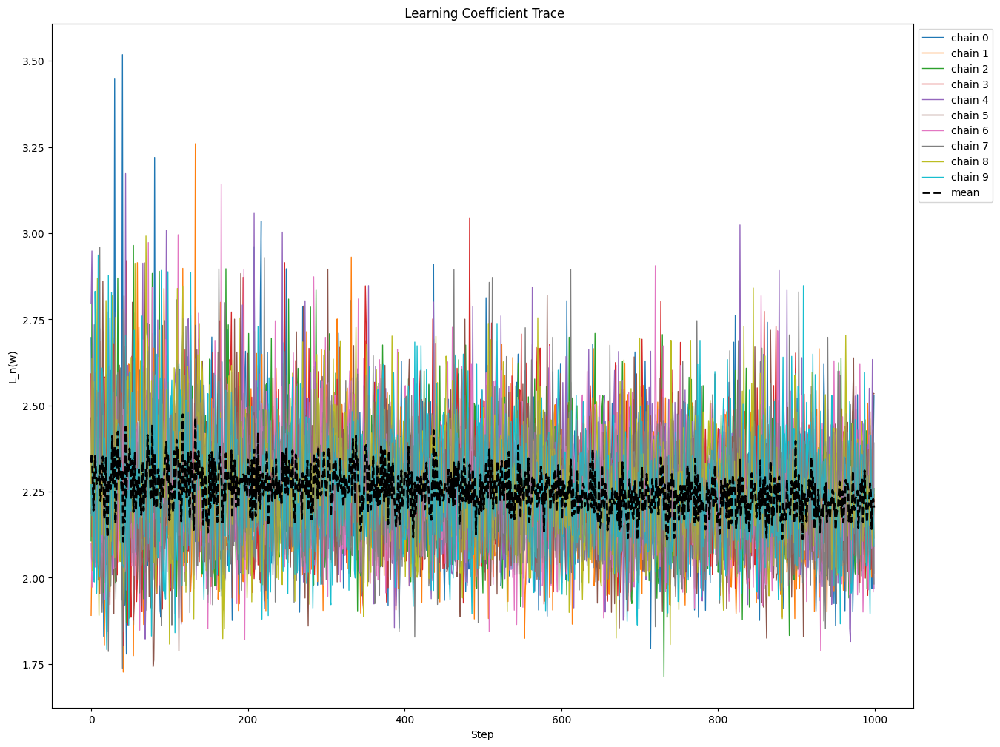

<Figure size 1200x900 with 0 Axes>

Chain 9: 100%|██████████| 1050/1050 [00:58<00:00, 17.87it/s]


Lambda hat estimates for adam_checkpoint300: 
llc-chain/0: -142.28172302246094
llc-chain/1: -293.05810546875
llc-chain/2: -39.79269790649414
llc-chain/3: -22.06188201904297
llc-chain/4: -113.65548706054688
llc-chain/5: -183.42298889160156
llc-chain/6: -145.03285217285156
llc-chain/7: -217.58123779296875
llc-chain/8: -63.334259033203125
llc-chain/9: -177.83480834960938
llc/mean: -139.80560302734375
llc/std: 83.87516784667969



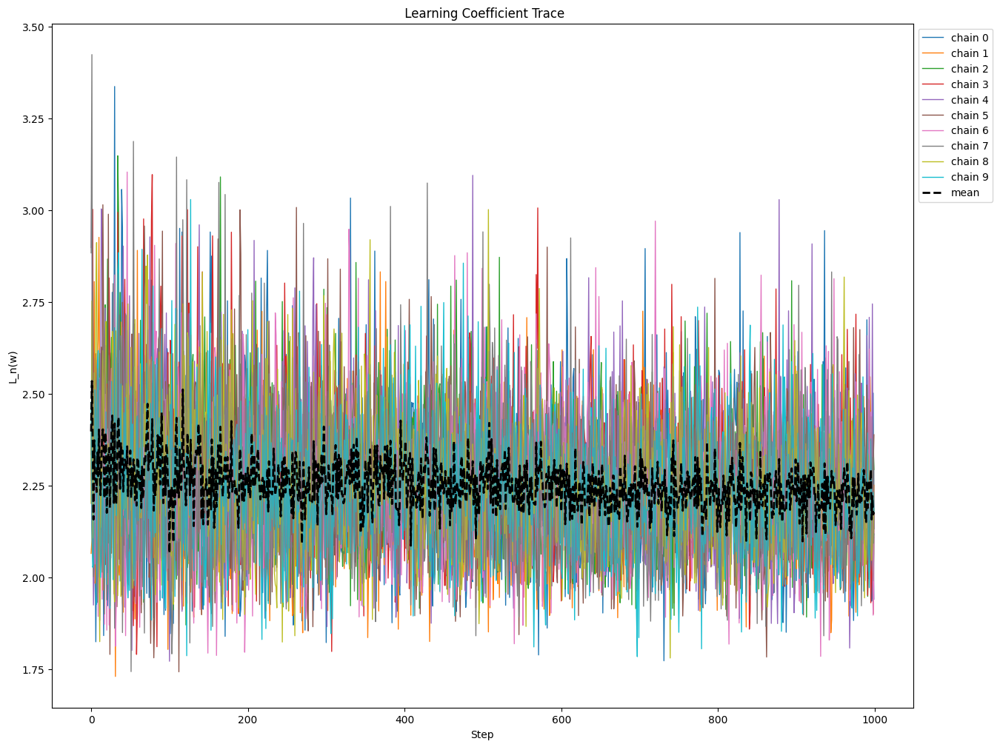

<Figure size 1200x900 with 0 Axes>

Chain 9: 100%|██████████| 1050/1050 [01:00<00:00, 17.42it/s]


Lambda hat estimates for adam_checkpoint400: 
llc-chain/0: -59.32270812988281
llc-chain/1: -203.6228790283203
llc-chain/2: -142.49436950683594
llc-chain/3: -173.1621856689453
llc-chain/4: -298.51959228515625
llc-chain/5: -307.1211242675781
llc-chain/6: -204.95492553710938
llc-chain/7: -293.777587890625
llc-chain/8: -134.22666931152344
llc-chain/9: -433.580322265625
llc/mean: -225.0782470703125
llc/std: 108.74380493164062



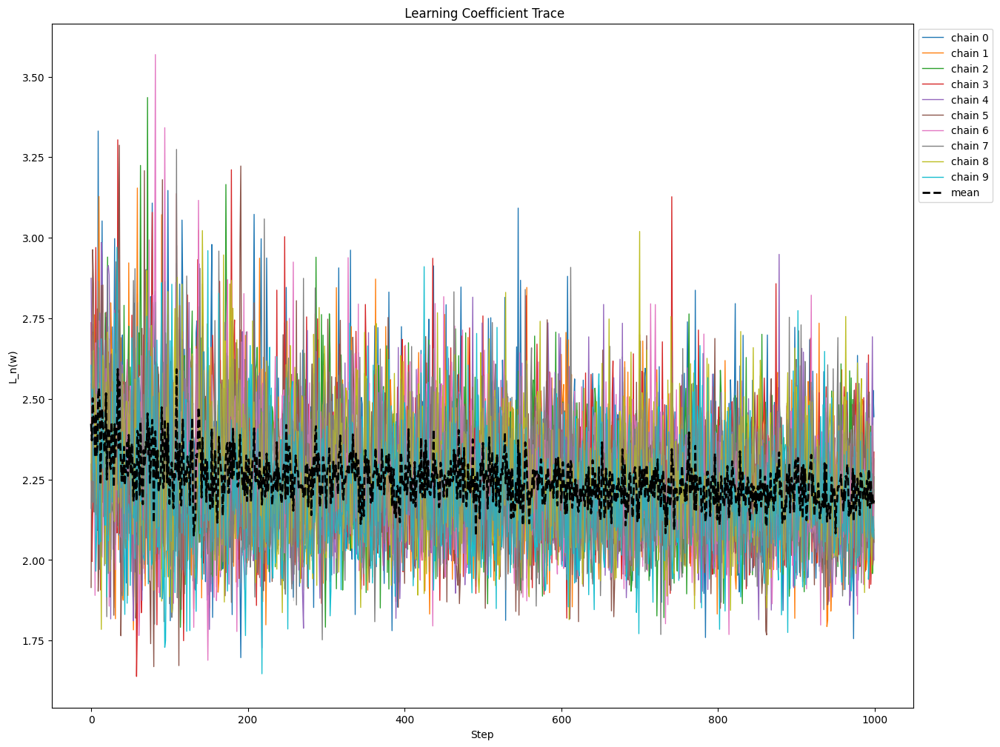

<Figure size 1200x900 with 0 Axes>

Chain 9: 100%|██████████| 1050/1050 [01:00<00:00, 17.45it/s]


Lambda hat estimates for adam_checkpoint500: 
llc-chain/0: 268.801513671875
llc-chain/1: 333.4479675292969
llc-chain/2: 318.6600036621094
llc-chain/3: 278.0299377441406
llc-chain/4: 282.5968017578125
llc-chain/5: 275.783447265625
llc-chain/6: 136.14706420898438
llc-chain/7: 320.19805908203125
llc-chain/8: 326.9342956542969
llc-chain/9: 282.5207824707031
llc/mean: 282.3119812011719
llc/std: 56.735618591308594



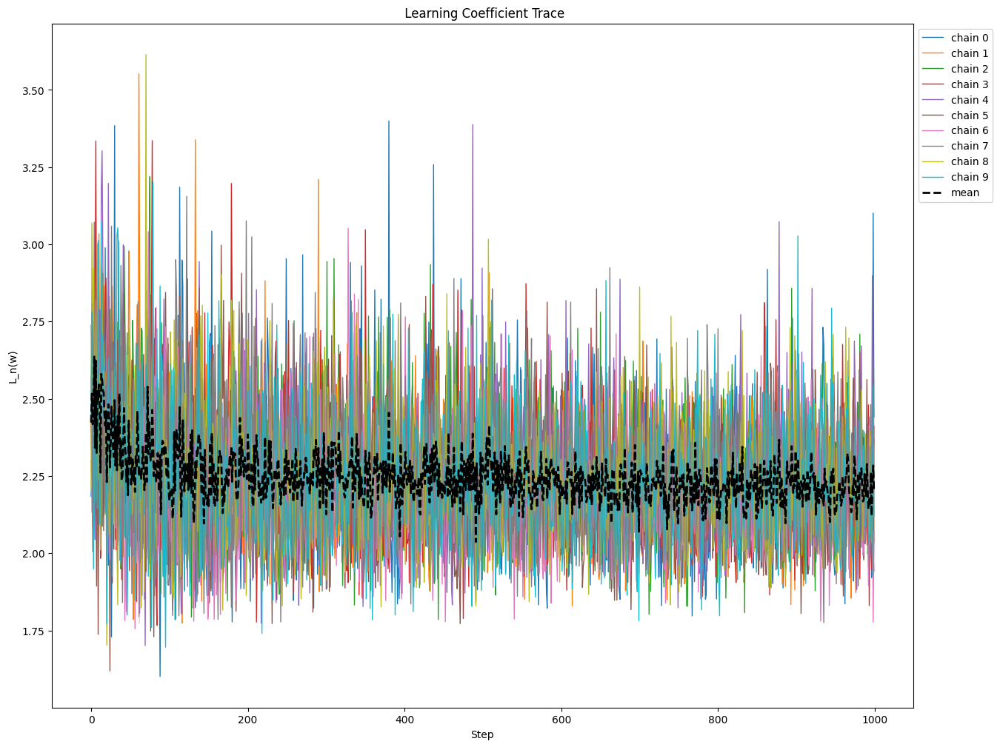

<Figure size 1200x900 with 0 Axes>

Chain 9: 100%|██████████| 1050/1050 [01:02<00:00, 16.91it/s]


Lambda hat estimates for adam_checkpoint600: 
llc-chain/0: 613.6495361328125
llc-chain/1: 598.8119506835938
llc-chain/2: 591.0885620117188
llc-chain/3: 495.3687744140625
llc-chain/4: 570.5305786132812
llc-chain/5: 540.4224243164062
llc-chain/6: 515.9267578125
llc-chain/7: 516.99658203125
llc-chain/8: 675.3256225585938
llc-chain/9: 576.085693359375
llc/mean: 569.420654296875
llc/std: 54.24789047241211



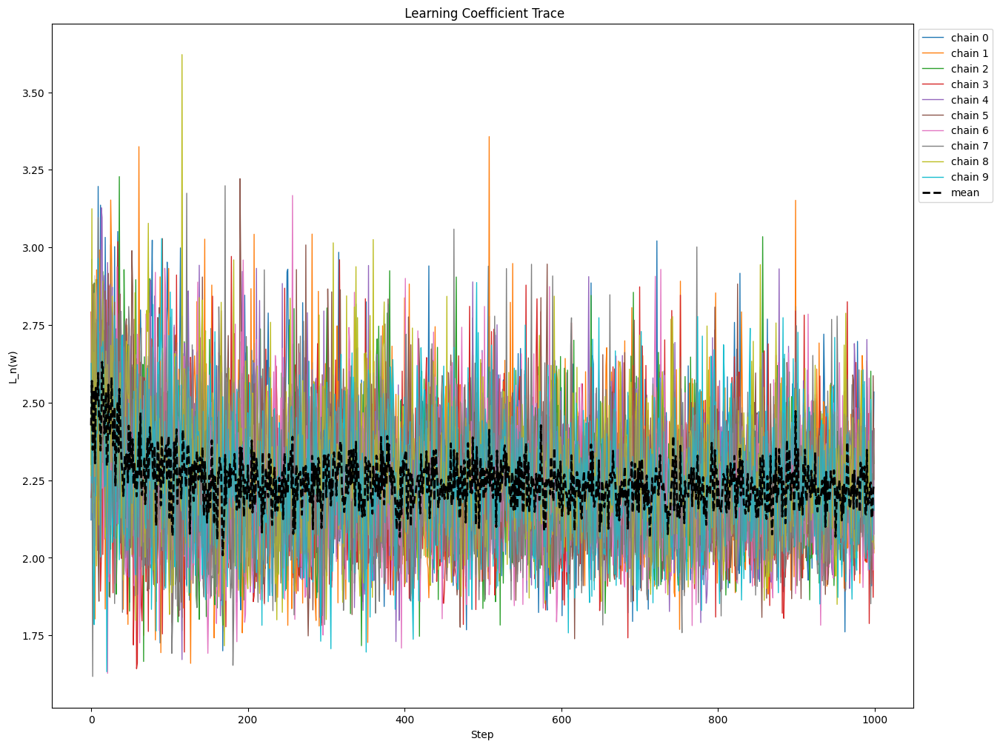

<Figure size 1200x900 with 0 Axes>

Chain 9: 100%|██████████| 1050/1050 [01:03<00:00, 16.66it/s]


Lambda hat estimates for adam_checkpoint700: 
llc-chain/0: 2174.3056640625
llc-chain/1: 2171.799072265625
llc-chain/2: 2250.030517578125
llc-chain/3: 2259.38330078125
llc-chain/4: 2159.947265625
llc-chain/5: 2191.41943359375
llc-chain/6: 2233.68017578125
llc-chain/7: 2113.928466796875
llc-chain/8: 2343.11474609375
llc-chain/9: 2360.768310546875
llc/mean: 2225.837646484375
llc/std: 79.83174133300781



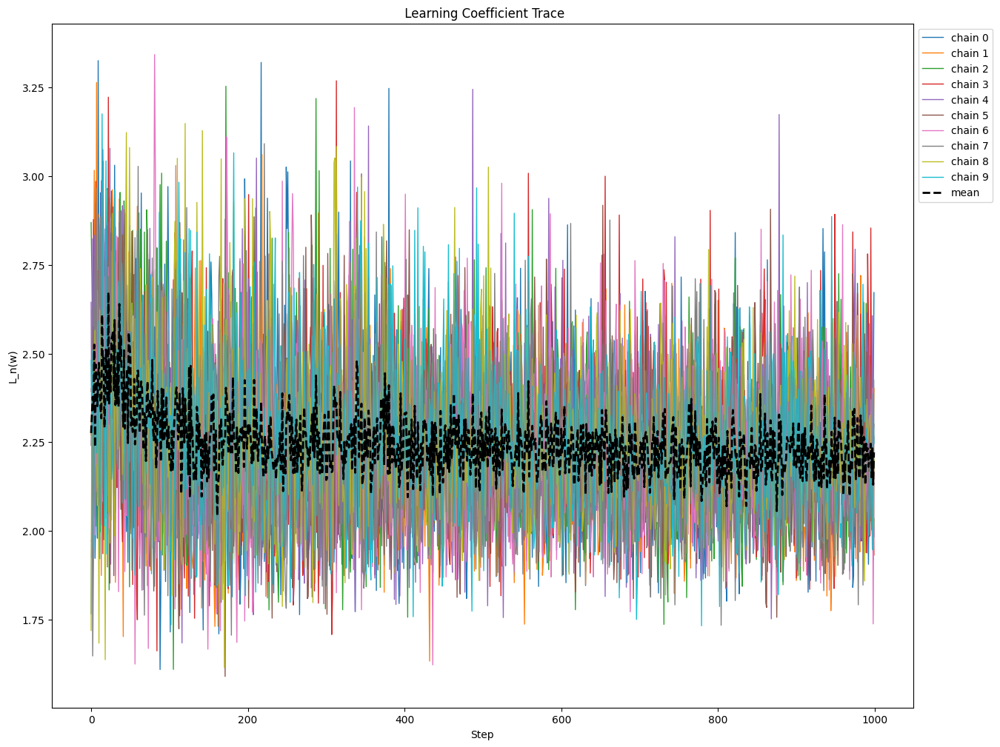

<Figure size 1200x900 with 0 Axes>

Chain 4:  11%|█         | 118/1050 [00:12<01:59,  7.83it/s]

In [ ]:
original_checkpoint = checkpoints_path + 'adam_checkpoint_with_noise'
name = 'sgd_checkpoint' if not use_adam_op else 'adam_checkpoint'

checkpoints = [10] + list(range(100, 1500, 100))
all_results = []

for i in range(len(checkpoints)):

      checkpoint_name = original_checkpoint + str(checkpoints[i]) + '.pth'
      right_name = name + str(checkpoints[i])
      checkpoint = torch.load(checkpoint_name, map_location = device)
      model.load_state_dict(checkpoint['model_state'])

      torch.manual_seed(0)
      checkpoint_rlcts = estimate_learning_coeff_with_summary(
          model,
          loader=trainloader,
          criterion=criterion,
          sampling_method=SGLD,
          optimizer_kwargs= optim_kwargs,
          num_chains=NUM_CHAINS,  # How many independent chains to run
          num_draws=NUM_DRAWS,  # How many samples to draw per chain
          num_burnin_steps=50,  # How many samples to discard at the beginning of each chain
          num_steps_bw_draws=1,  # How many steps to take between each sample
          device=device,
          )

      current_checkpoint = rlcts_path + right_name + '_rlcts.pt' if not use_label_noise else rlcts_path + right_name + '_with_noise' + '_rlcts.pt'
      torch.save(checkpoint_rlcts, current_checkpoint)

      all_results.append(checkpoint_rlcts)

      trace = checkpoint_rlcts.pop("loss/trace")

      print(f"Lambda hat estimates for {right_name}: ")
      print(yaml.dump(checkpoint_rlcts))
      plot_trace(trace, 'L_n(w)', x_axis='Step', title=' Learning Coefficient Trace', plot_mean=False, plot_std=False, fig_size=(12, 9), true_lc = None)
      plt.show()

torch.save(all_results, rlcts_path + 'all_results.pt')

Chain 9: 100%|██████████| 1050/1050 [00:50<00:00, 20.76it/s]


Lambda hat estimates for adam_checkpoint800: 
llc-chain/0: 1831.78515625
llc-chain/1: 1862.3096923828125
llc-chain/2: 1942.6024169921875
llc-chain/3: 1905.1190185546875
llc-chain/4: 1802.2366943359375
llc-chain/5: 1888.245361328125
llc-chain/6: 1747.97216796875
llc-chain/7: 1816.0242919921875
llc-chain/8: 1948.3636474609375
llc-chain/9: 1885.7564697265625
llc/mean: 1863.0413818359375
llc/std: 63.82075500488281



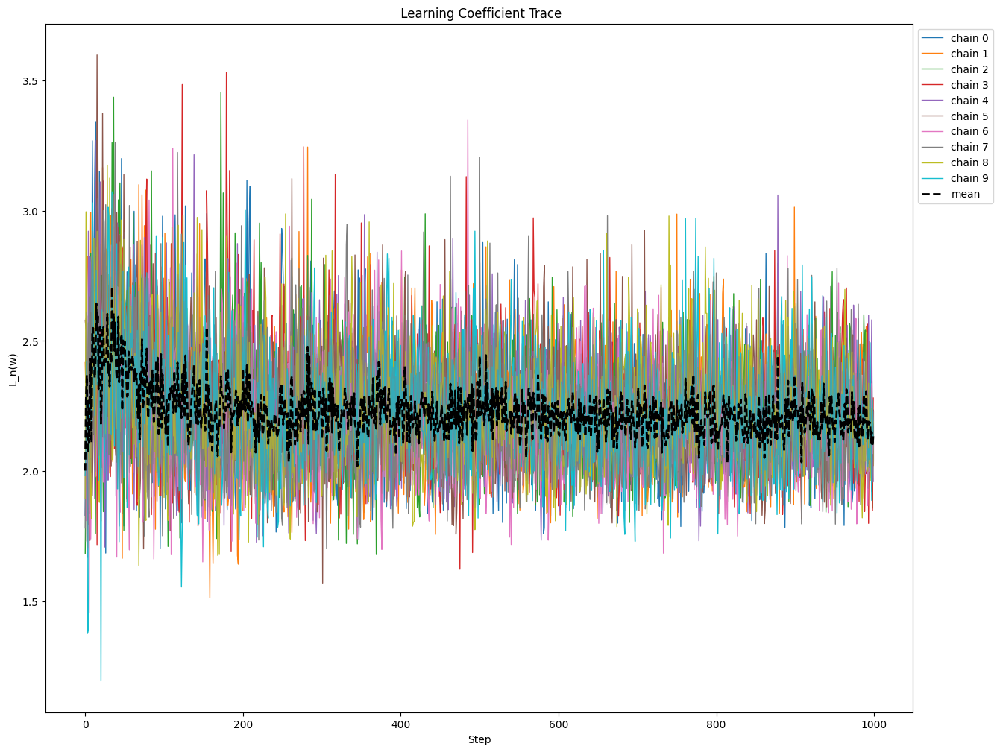

<Figure size 1200x900 with 0 Axes>

Chain 9: 100%|██████████| 1050/1050 [00:52<00:00, 19.95it/s]


Lambda hat estimates for adam_checkpoint900: 
llc-chain/0: 2609.6708984375
llc-chain/1: 2711.125244140625
llc-chain/2: 2837.31787109375
llc-chain/3: 2687.021728515625
llc-chain/4: 2726.6083984375
llc-chain/5: 2745.217529296875
llc-chain/6: 2638.181396484375
llc-chain/7: 2623.960693359375
llc-chain/8: 2811.4404296875
llc-chain/9: 2616.3662109375
llc/mean: 2700.691162109375
llc/std: 81.01628112792969



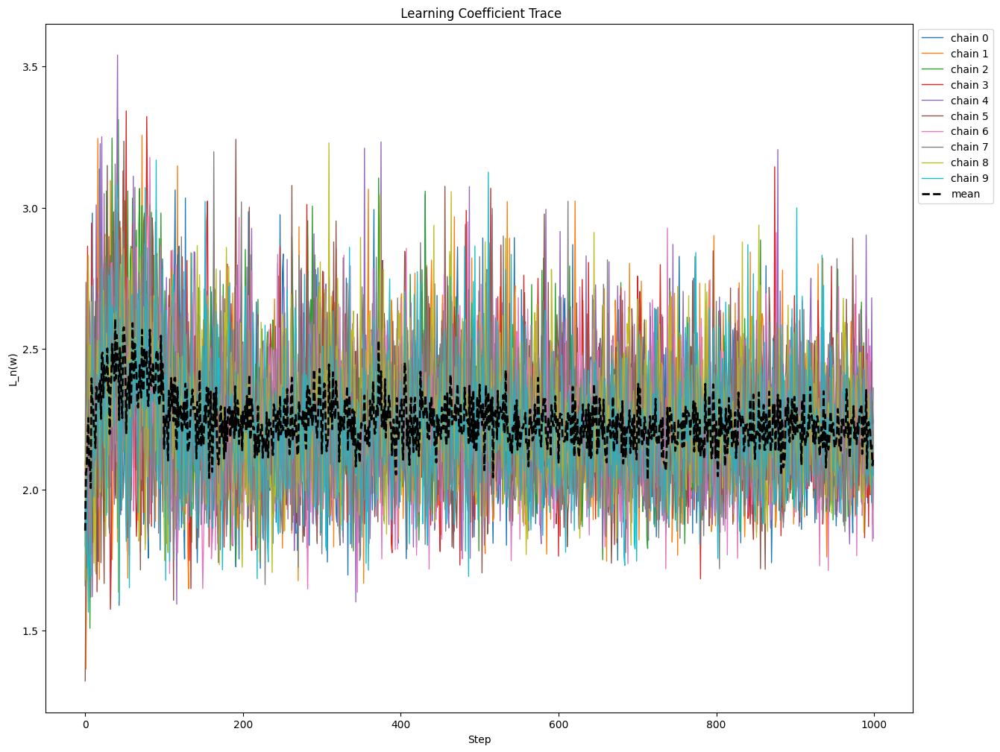

<Figure size 1200x900 with 0 Axes>

Chain 9: 100%|██████████| 1050/1050 [00:55<00:00, 19.07it/s]


Lambda hat estimates for adam_checkpoint1000: 
llc-chain/0: 1117.027587890625
llc-chain/1: 1226.8621826171875
llc-chain/2: 1270.973876953125
llc-chain/3: 1168.2755126953125
llc-chain/4: 1186.9361572265625
llc-chain/5: 1187.63134765625
llc-chain/6: 1163.761474609375
llc-chain/7: 1221.9835205078125
llc-chain/8: 1305.2774658203125
llc-chain/9: 1288.569091796875
llc/mean: 1213.7298583984375
llc/std: 60.380859375



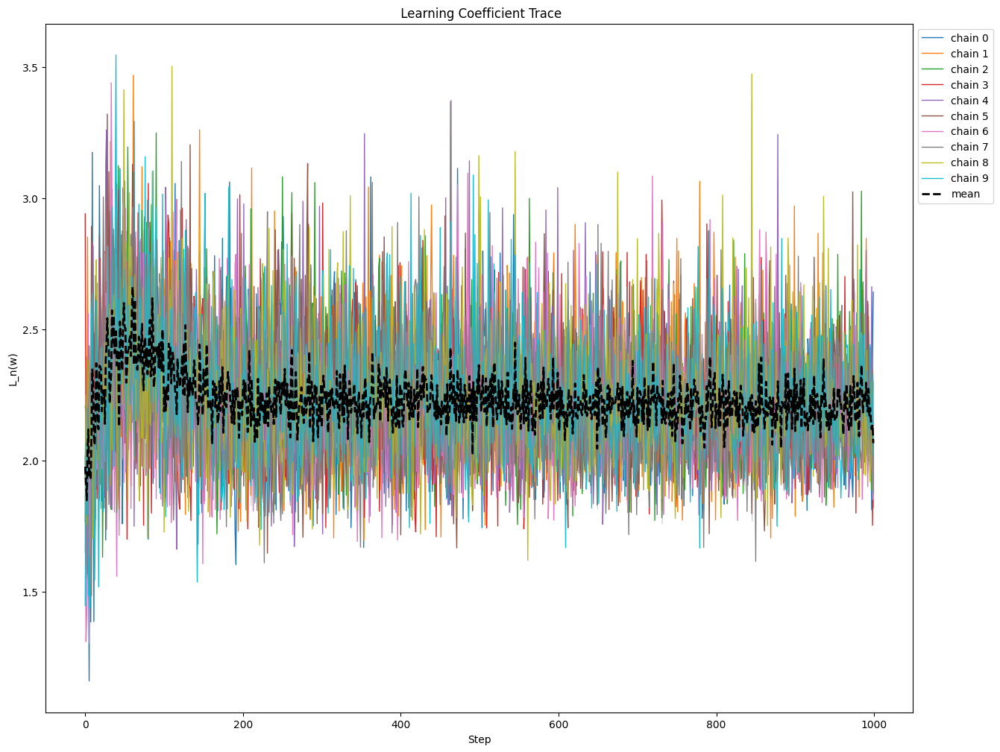

<Figure size 1200x900 with 0 Axes>

Chain 9: 100%|██████████| 1050/1050 [00:58<00:00, 18.05it/s]


Lambda hat estimates for adam_checkpoint1100: 
llc-chain/0: 2191.67236328125
llc-chain/1: 2256.01904296875
llc-chain/2: 2341.318359375
llc-chain/3: 2268.506591796875
llc-chain/4: 2154.604248046875
llc-chain/5: 2298.87353515625
llc-chain/6: 2292.134033203125
llc-chain/7: 2232.716552734375
llc-chain/8: 2434.1005859375
llc-chain/9: 2222.431640625
llc/mean: 2269.23779296875
llc/std: 79.3270492553711



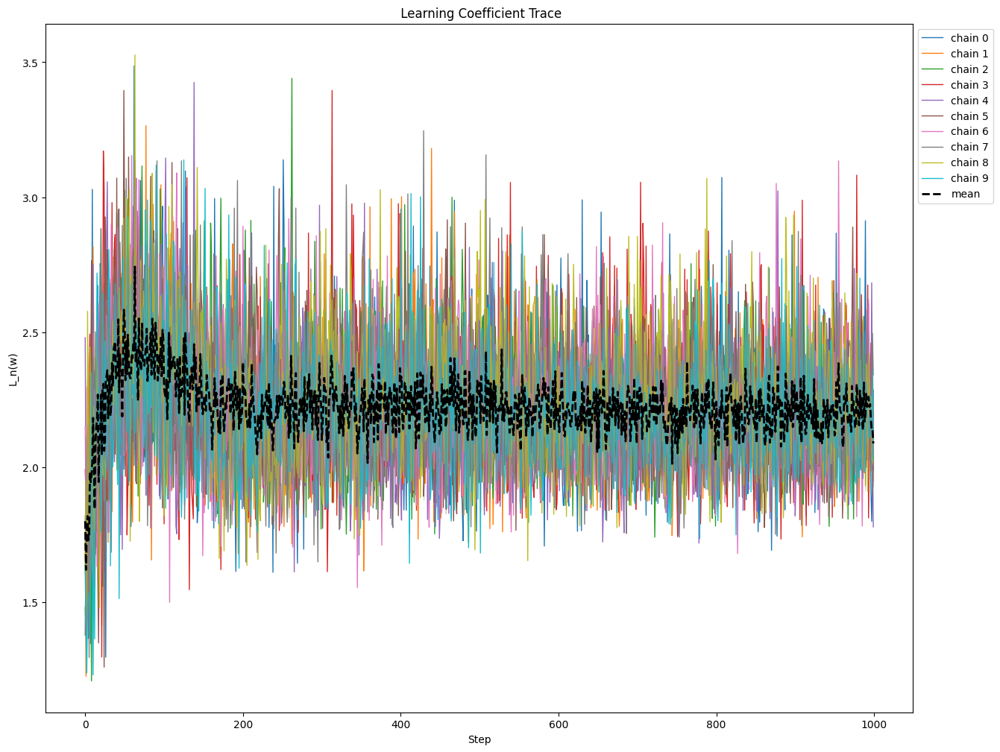

<Figure size 1200x900 with 0 Axes>

Chain 9: 100%|██████████| 1050/1050 [00:57<00:00, 18.30it/s]


Lambda hat estimates for adam_checkpoint1200: 
llc-chain/0: 4162.52587890625
llc-chain/1: 4235.8974609375
llc-chain/2: 4313.65478515625
llc-chain/3: 4316.48974609375
llc-chain/4: 4154.53564453125
llc-chain/5: 4367.41259765625
llc-chain/6: 4210.17431640625
llc-chain/7: 4272.65576171875
llc-chain/8: 4366.998046875
llc-chain/9: 4232.92333984375
llc/mean: 4263.32666015625
llc/std: 77.1190414428711



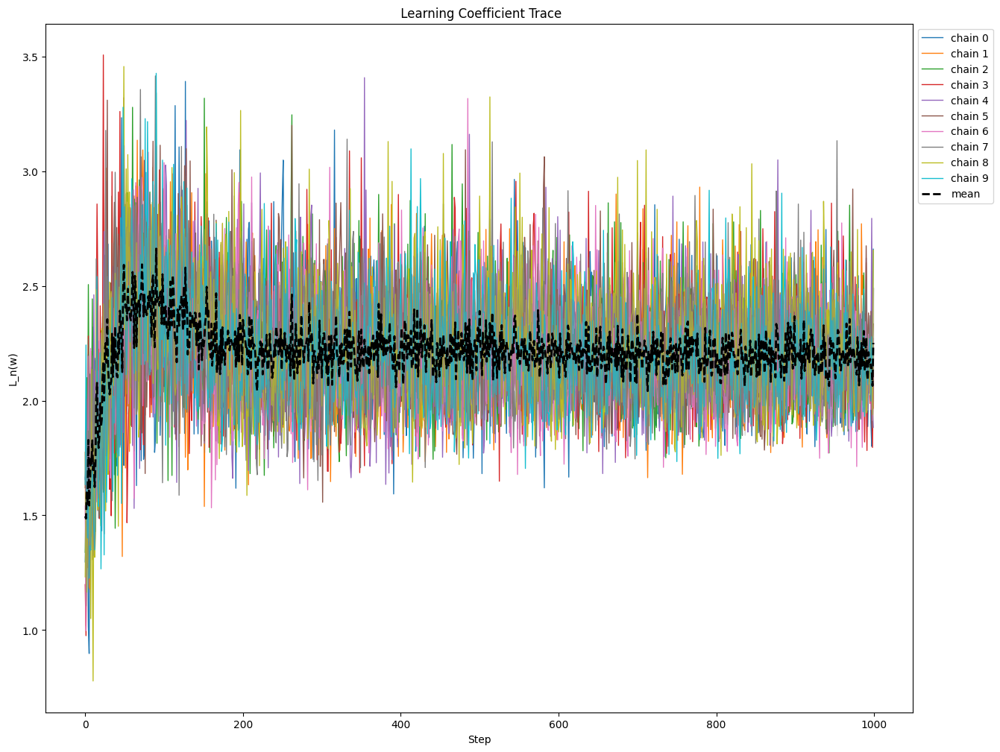

<Figure size 1200x900 with 0 Axes>

Chain 9: 100%|██████████| 1050/1050 [00:59<00:00, 17.69it/s]


Lambda hat estimates for adam_checkpoint1300: 
llc-chain/0: 3934.049072265625
llc-chain/1: 3907.4423828125
llc-chain/2: 3932.4736328125
llc-chain/3: 4074.521728515625
llc-chain/4: 3786.1494140625
llc-chain/5: 3838.544189453125
llc-chain/6: 3844.0234375
llc-chain/7: 3958.880859375
llc-chain/8: 4009.239501953125
llc-chain/9: 3940.8779296875
llc/mean: 3922.620361328125
llc/std: 84.69145202636719



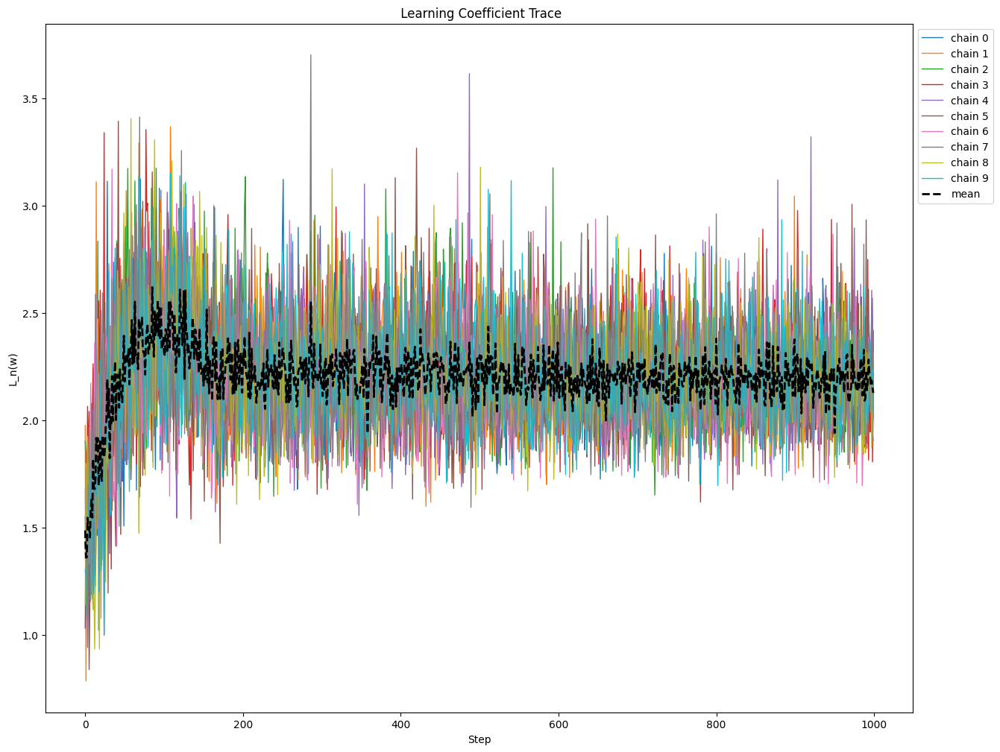

<Figure size 1200x900 with 0 Axes>

Chain 9: 100%|██████████| 1050/1050 [01:04<00:00, 16.25it/s]


Lambda hat estimates for adam_checkpoint1400: 
llc-chain/0: 4009.28466796875
llc-chain/1: 4196.46484375
llc-chain/2: 4146.36279296875
llc-chain/3: 4272.41455078125
llc-chain/4: 4115.29296875
llc-chain/5: 4164.24365234375
llc-chain/6: 4109.00927734375
llc-chain/7: 4118.1650390625
llc-chain/8: 4326.6865234375
llc-chain/9: 4169.9619140625
llc/mean: 4162.78857421875
llc/std: 88.84487915039062



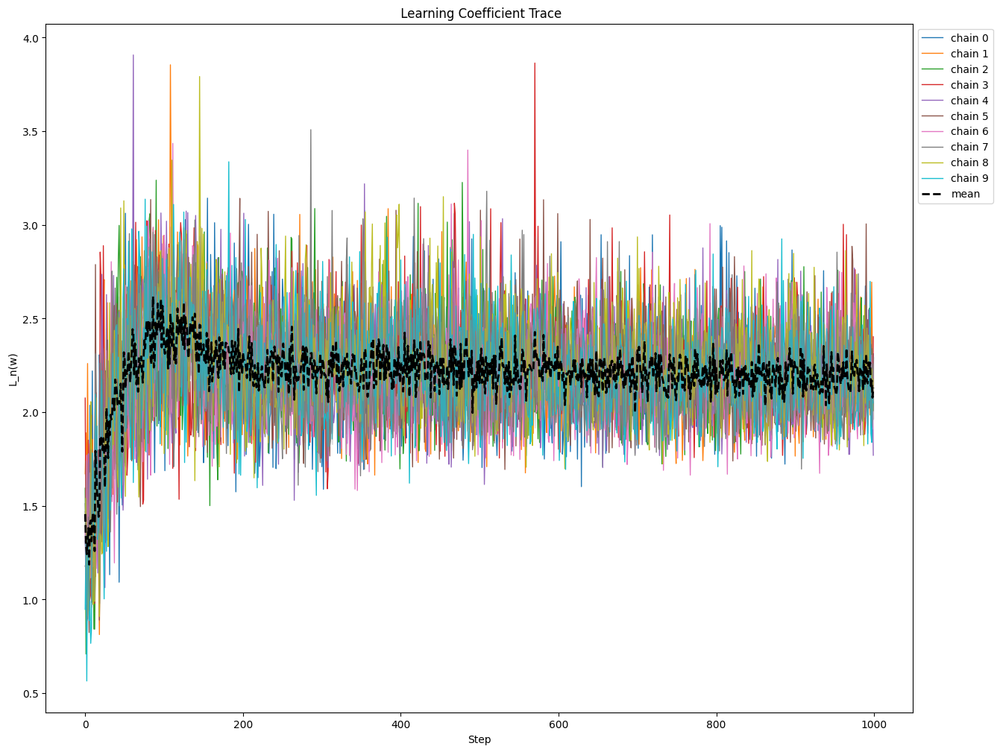

<Figure size 1200x900 with 0 Axes>

In [ ]:
original_checkpoint = checkpoints_path + 'adam_checkpoint_with_noise'
name = 'sgd_checkpoint' if not use_adam_op else 'adam_checkpoint'

checkpoints = list(range(800, 1500, 100))
all_results = []

for i in range(len(checkpoints)):

      checkpoint_name = original_checkpoint + str(checkpoints[i]) + '.pth'
      right_name = name + str(checkpoints[i])
      checkpoint = torch.load(checkpoint_name, map_location = device)
      model.load_state_dict(checkpoint['model_state'])

      torch.manual_seed(0)
      checkpoint_rlcts = estimate_learning_coeff_with_summary(
          model,
          loader=trainloader,
          criterion=criterion,
          sampling_method=SGLD,
          optimizer_kwargs= optim_kwargs,
          num_chains=NUM_CHAINS,  # How many independent chains to run
          num_draws=NUM_DRAWS,  # How many samples to draw per chain
          num_burnin_steps=50,  # How many samples to discard at the beginning of each chain
          num_steps_bw_draws=1,  # How many steps to take between each sample
          device=device,
          )

      current_checkpoint = rlcts_path + right_name + '_rlcts.pt' if not use_label_noise else rlcts_path + right_name + '_with_noise' + '_rlcts.pt'
      torch.save(checkpoint_rlcts, current_checkpoint)

      all_results.append(checkpoint_rlcts)

      trace = checkpoint_rlcts.pop("loss/trace")

      print(f"Lambda hat estimates for {right_name}: ")
      print(yaml.dump(checkpoint_rlcts))
      plot_trace(trace, 'L_n(w)', x_axis='Step', title=' Learning Coefficient Trace', plot_mean=False, plot_std=False, fig_size=(12, 9), true_lc = None)
      plt.show()

torch.save(all_results, rlcts_path + 'all_results.pt')

In [ ]:
# Let's load the final checkpoint
last_checkpoint = torch.load(checkpoints_path + 'final_checkpoint_with_noise.pth', map_location = device)

In [ ]:
# Now we can load the model and optimizer states from the final checkpoint
model.load_state_dict(last_checkpoint['model_state'])
optimizer.load_state_dict(last_checkpoint['optim_state'])

In [ ]:
#Let's estimate the learning coefficient in the last checkpoint
torch.manual_seed(0)
final_rlcts = estimate_learning_coeff_with_summary(
    model,
    loader=trainloader,
    criterion=criterion,
    sampling_method=SGLD,
    optimizer_kwargs=optim_kwargs,
    num_chains=NUM_CHAINS,  # How many independent chains to run
    num_draws=NUM_DRAWS,  # How many samples to draw per chain
    num_burnin_steps=50,  # How many samples to discard at the beginning of each chain
    num_steps_bw_draws=1,  # How many steps to take between each sample
    device=device,
)

Chain 9: 100%|██████████| 1050/1050 [00:54<00:00, 19.30it/s]


In [ ]:
pref = rlcts_path + 'sgd_' if not use_adam_op else rlcts_path + 'adam_'
rlcts_final = pref + 'final_model_rlcts.pt' if not use_label_noise else pref + 'final_model_with_noise_rlcts.pt'
torch.save(final_rlcts, rlcts_final)

In [ ]:
trace = final_rlcts.pop("loss/trace")

print("Lambda hat estimates: ")
print(yaml.dump(final_rlcts))

Lambda hat estimates: 
llc-chain/0: 5661.34619140625
llc-chain/1: 5560.537109375
llc-chain/2: 5596.08154296875
llc-chain/3: 5685.50927734375
llc-chain/4: 5490.95166015625
llc-chain/5: 5658.7314453125
llc-chain/6: 5638.03271484375
llc-chain/7: 5646.0302734375
llc-chain/8: 5881.7158203125
llc-chain/9: 5660.9716796875
llc/mean: 5647.99072265625
llc/std: 100.8873291015625



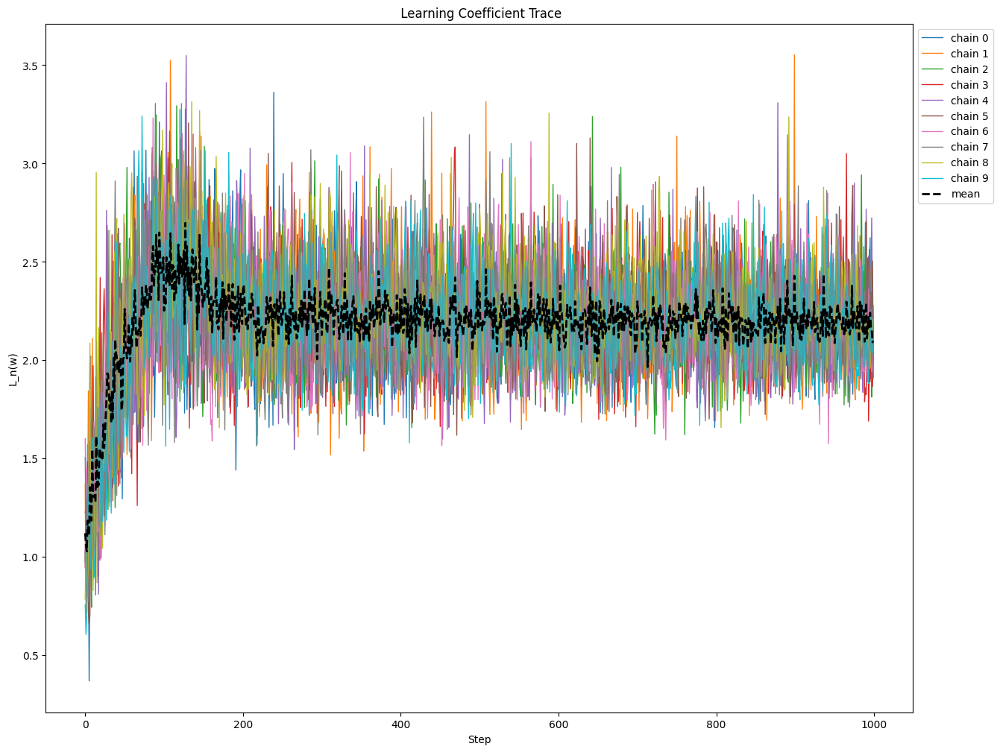

<Figure size 1200x900 with 0 Axes>

In [ ]:
plot_trace(trace, 'L_n(w)', x_axis='Step', title=' Learning Coefficient Trace', plot_mean=False, plot_std=False, fig_size=(12, 9), true_lc = None)

In [ ]:
# Let's load the checkpoint at the peak
peak_checkpoint = torch.load(checkpoints_path + 'adam_checkpoint_with_noise90.pth', map_location = device)

In [ ]:
# Now we can load the model and optimizer states from the final checkpoint
model.load_state_dict(last_checkpoint['model_state'])
optimizer.load_state_dict(last_checkpoint['optim_state'])

In [ ]:
#Let's estimate the learning coefficient in the peak checkpoint
torch.manual_seed(0)
peak_rlcts = estimate_learning_coeff_with_summary(
    model,
    loader=trainloader,
    criterion=criterion,
    sampling_method=SGLD,
    optimizer_kwargs=optim_kwargs,
    num_chains=NUM_CHAINS,  # How many independent chains to run
    num_draws=NUM_DRAWS,  # How many samples to draw per chain
    num_burnin_steps=50,  # How many samples to discard at the beginning of each chain
    num_steps_bw_draws=1,  # How many steps to take between each sample
    device=device,
)

Chain 9: 100%|██████████| 1050/1050 [00:55<00:00, 18.97it/s]


In [ ]:
pref = rlcts_path + 'sgd_' if not use_adam_op else rlcts_path + 'adam_'
rlcts_final = pref + 'peak_final_model_rlcts.pt' if not use_label_noise else pref + 'peak_model_with_noise_rlcts.pt'
torch.save(peak_rlcts, rlcts_final)

In [ ]:
trace = peak_rlcts.pop("loss/trace")

print("Lambda hat estimates: ")
print(yaml.dump(final_rlcts))

Lambda hat estimates: 
llc-chain/0: 5661.34619140625
llc-chain/1: 5560.537109375
llc-chain/2: 5596.08154296875
llc-chain/3: 5685.50927734375
llc-chain/4: 5490.95166015625
llc-chain/5: 5658.7314453125
llc-chain/6: 5638.03271484375
llc-chain/7: 5646.0302734375
llc-chain/8: 5881.7158203125
llc-chain/9: 5660.9716796875
llc/mean: 5647.99072265625
llc/std: 100.8873291015625



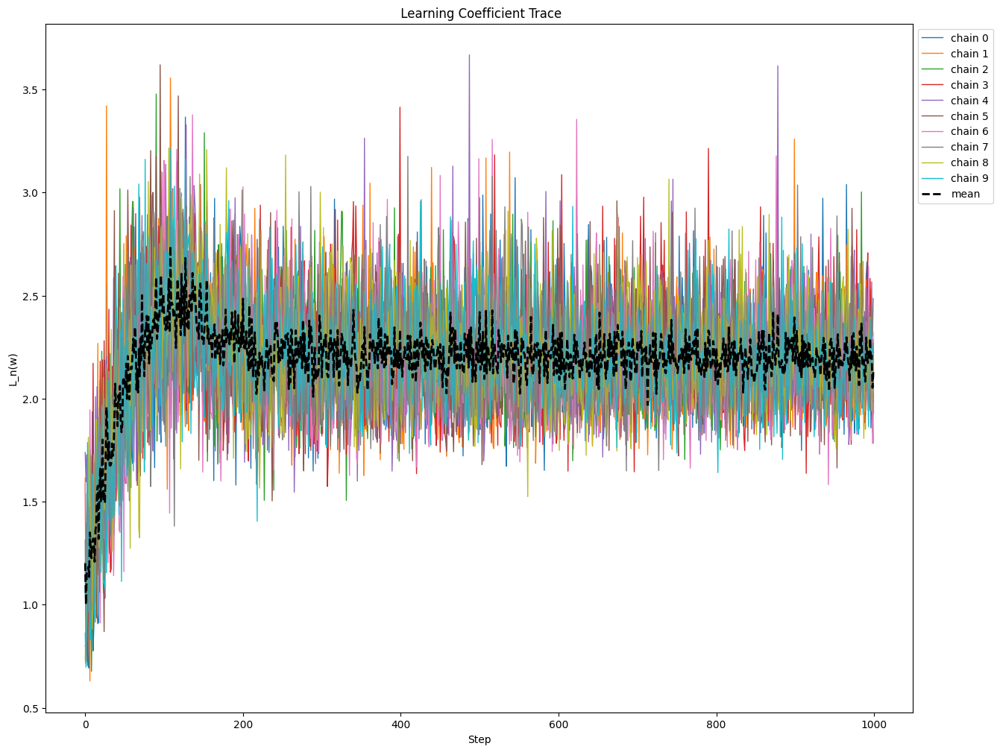

<Figure size 1200x900 with 0 Axes>

In [ ]:
plot_trace(trace, 'L_n(w)', x_axis='Step', title=' Learning Coefficient Trace', plot_mean=False, plot_std=False, fig_size=(12, 9), true_lc = None)

Chain 9: 100%|██████████| 1000/1000 [00:50<00:00, 19.81it/s]


Lambda hat estimates for adam_checkpoint10: 
llc-chain/0: 5060.13134765625
llc-chain/1: 5115.73876953125
llc-chain/2: 5107.0810546875
llc-chain/3: 5133.27001953125
llc-chain/4: 5089.13427734375
llc-chain/5: 5122.02099609375
llc-chain/6: 5088.02587890625
llc-chain/7: 5180.904296875
llc-chain/8: 5152.55126953125
llc-chain/9: 4973.92431640625
llc/mean: 5102.2783203125
llc/std: 56.657779693603516



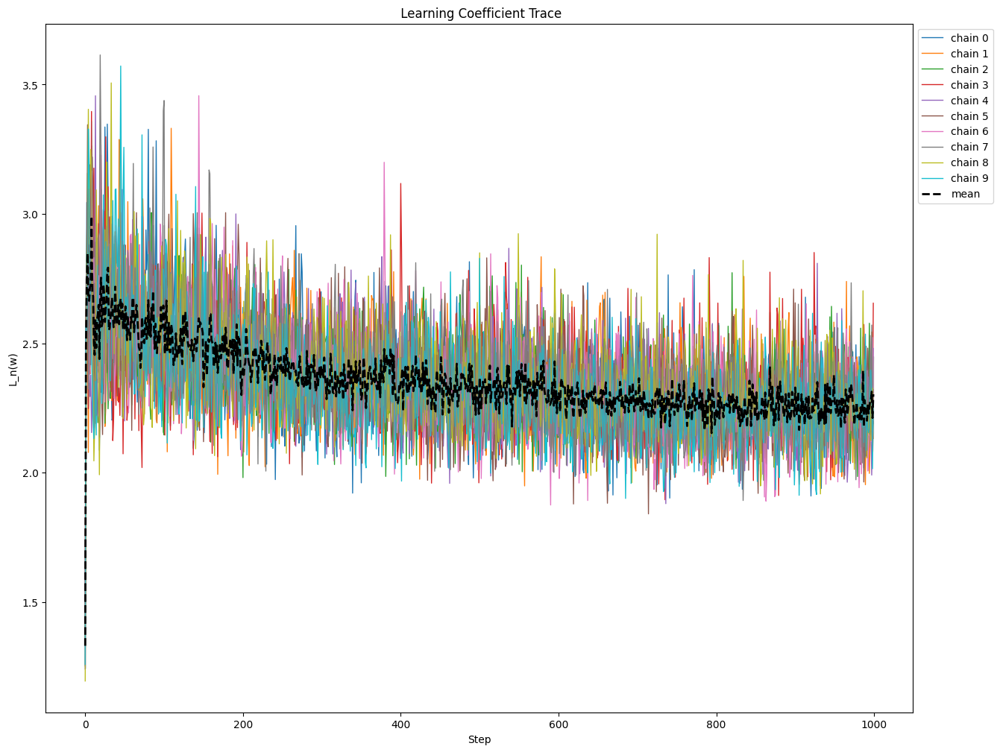

<Figure size 1200x900 with 0 Axes>

Chain 9: 100%|██████████| 1000/1000 [00:53<00:00, 18.81it/s]


Lambda hat estimates for adam_checkpoint90: 
llc-chain/0: 9044.2802734375
llc-chain/1: 9078.12890625
llc-chain/2: 9056.2265625
llc-chain/3: 9029.7724609375
llc-chain/4: 8995.5634765625
llc-chain/5: 9077.6533203125
llc-chain/6: 9176.9833984375
llc-chain/7: 9105.2353515625
llc-chain/8: 9115.2841796875
llc-chain/9: 9096.6494140625
llc/mean: 9077.578125
llc/std: 50.56181335449219



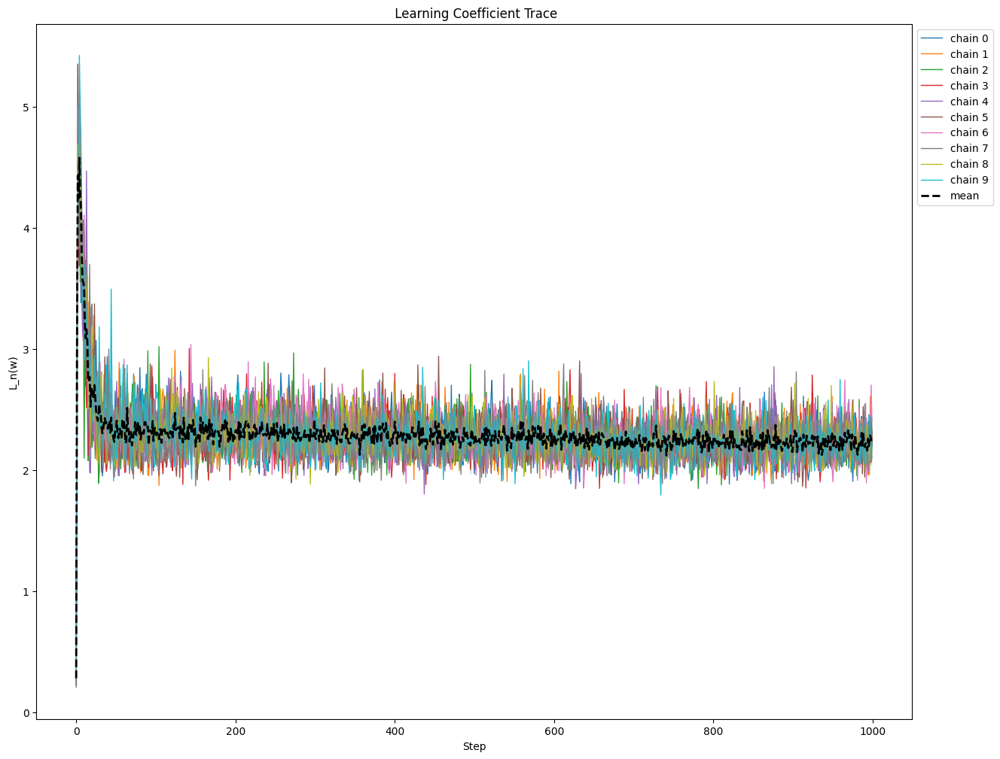

<Figure size 1200x900 with 0 Axes>

Chain 9: 100%|██████████| 1000/1000 [00:53<00:00, 18.63it/s]


Lambda hat estimates for adam_checkpoint100: 
llc-chain/0: 9506.076171875
llc-chain/1: 9589.1396484375
llc-chain/2: 9600.1552734375
llc-chain/3: 9547.064453125
llc-chain/4: 9489.04296875
llc-chain/5: 9513.5908203125
llc-chain/6: 9696.0966796875
llc-chain/7: 9515.6552734375
llc-chain/8: 9489.974609375
llc-chain/9: 9702.248046875
llc/mean: 9564.904296875
llc/std: 80.35452270507812



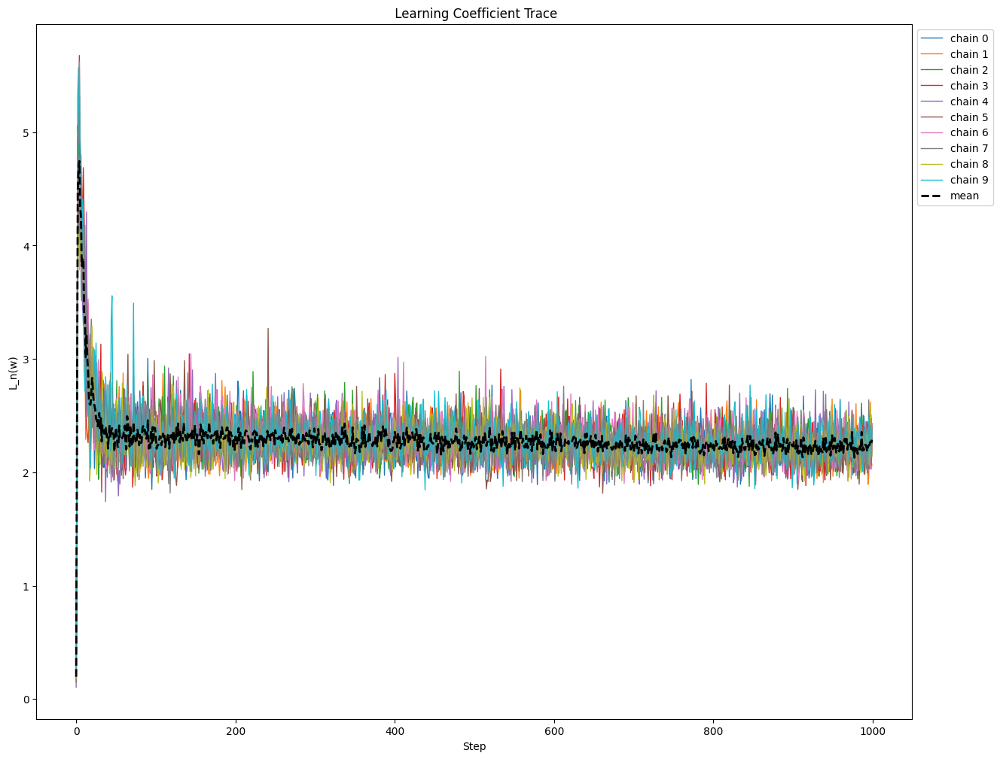

<Figure size 1200x900 with 0 Axes>

Chain 9: 100%|██████████| 1000/1000 [00:55<00:00, 18.10it/s]


Lambda hat estimates for adam_checkpoint200: 
llc-chain/0: 9810.23828125
llc-chain/1: 9799.2578125
llc-chain/2: 9816.89453125
llc-chain/3: 9755.0302734375
llc-chain/4: 9800.47265625
llc-chain/5: 9743.0166015625
llc-chain/6: 9789.6650390625
llc-chain/7: 9676.6123046875
llc-chain/8: 9755.994140625
llc-chain/9: 9885.8447265625
llc/mean: 9783.3037109375
llc/std: 55.28670883178711



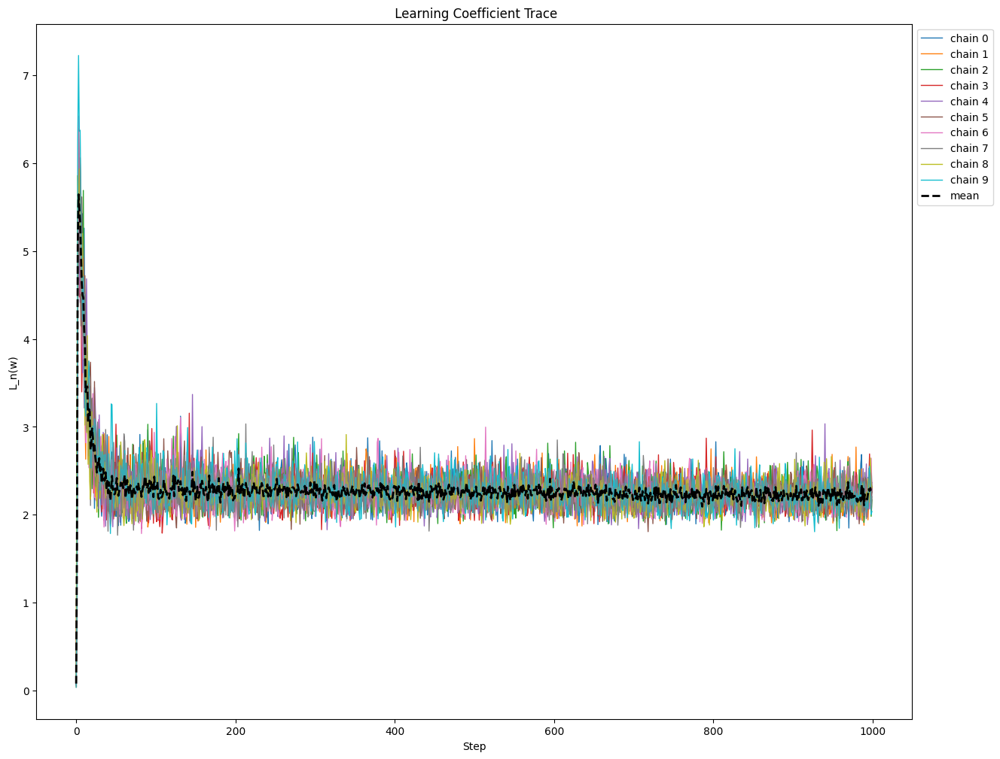

<Figure size 1200x900 with 0 Axes>

Chain 9: 100%|██████████| 1000/1000 [00:53<00:00, 18.66it/s]


Lambda hat estimates for adam_checkpoint300: 
llc-chain/0: 10101.7880859375
llc-chain/1: 10065.1279296875
llc-chain/2: 10185.3232421875
llc-chain/3: 10137.6669921875
llc-chain/4: 10111.4794921875
llc-chain/5: 9994.18359375
llc-chain/6: 10201.4287109375
llc-chain/7: 10068.0703125
llc-chain/8: 10122.73046875
llc-chain/9: 10177.55078125
llc/mean: 10116.53515625
llc/std: 63.5530891418457



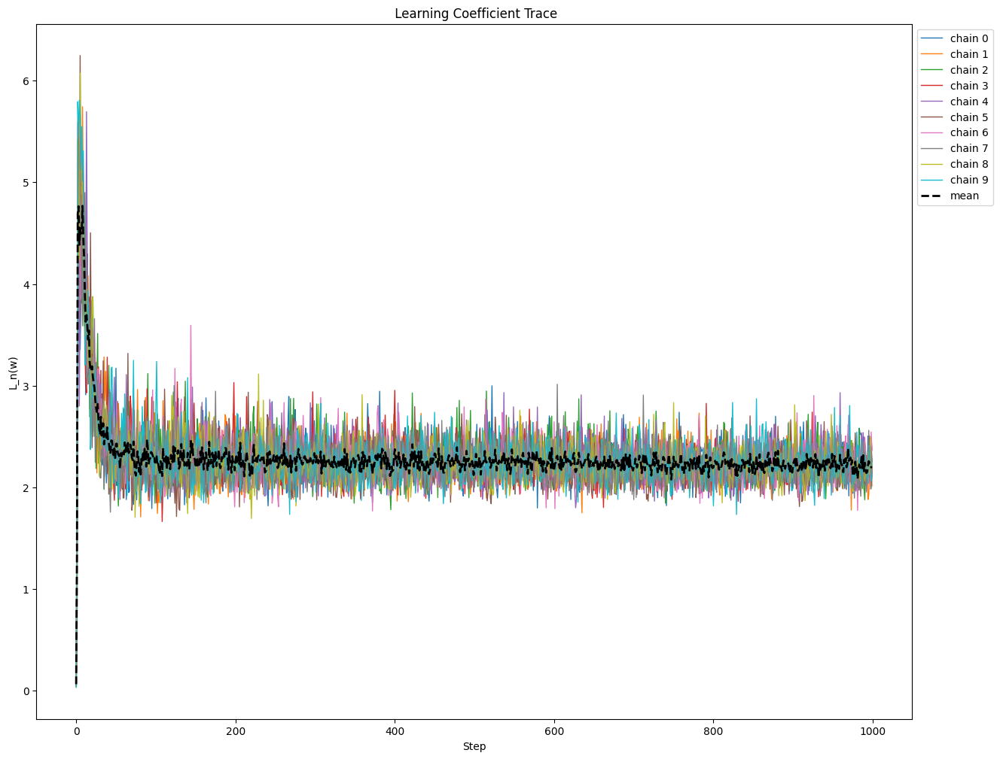

<Figure size 1200x900 with 0 Axes>

Chain 9: 100%|██████████| 1000/1000 [00:58<00:00, 17.17it/s]


Lambda hat estimates for adam_checkpoint400: 
llc-chain/0: 10241.9794921875
llc-chain/1: 10067.0380859375
llc-chain/2: 10298.095703125
llc-chain/3: 10127.1337890625
llc-chain/4: 10078.8701171875
llc-chain/5: 10101.623046875
llc-chain/6: 10208.4775390625
llc-chain/7: 10037.9775390625
llc-chain/8: 10139.630859375
llc-chain/9: 10244.4189453125
llc/mean: 10154.5244140625
llc/std: 88.18203735351562



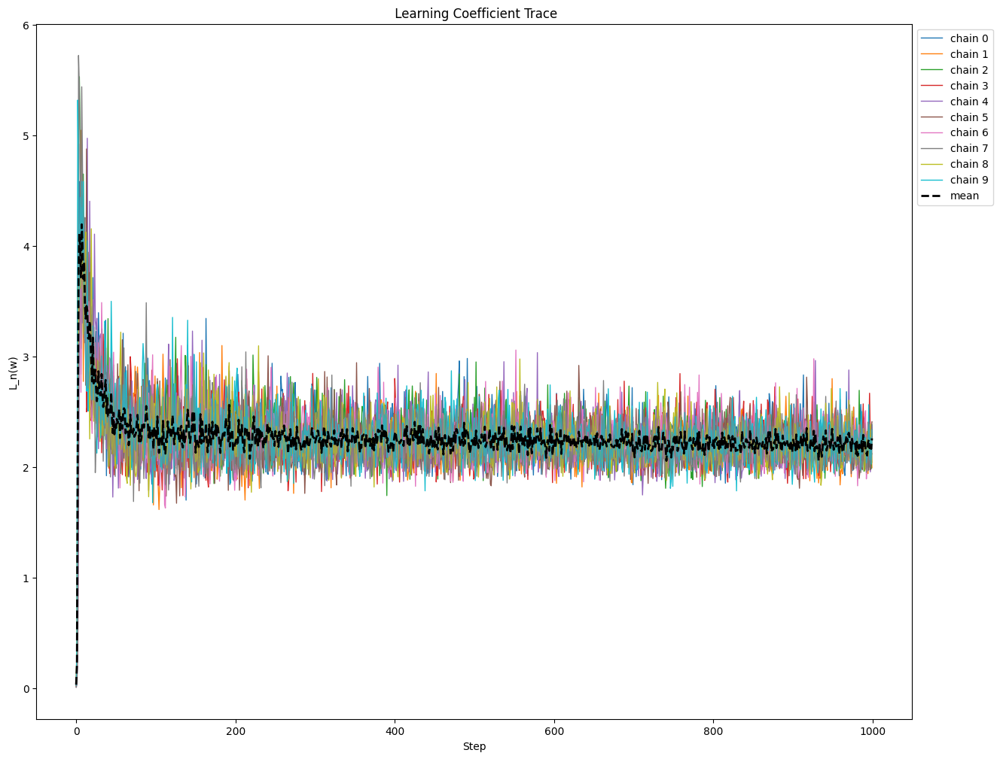

<Figure size 1200x900 with 0 Axes>

Chain 9: 100%|██████████| 1000/1000 [00:56<00:00, 17.67it/s]


Lambda hat estimates for adam_checkpoint500: 
llc-chain/0: 10356.9814453125
llc-chain/1: 10259.8642578125
llc-chain/2: 10326.5888671875
llc-chain/3: 10360.1611328125
llc-chain/4: 10372.4599609375
llc-chain/5: 10354.8408203125
llc-chain/6: 10400.3505859375
llc-chain/7: 10215.21875
llc-chain/8: 10325.7998046875
llc-chain/9: 10461.8359375
llc/mean: 10343.41015625
llc/std: 68.88970184326172



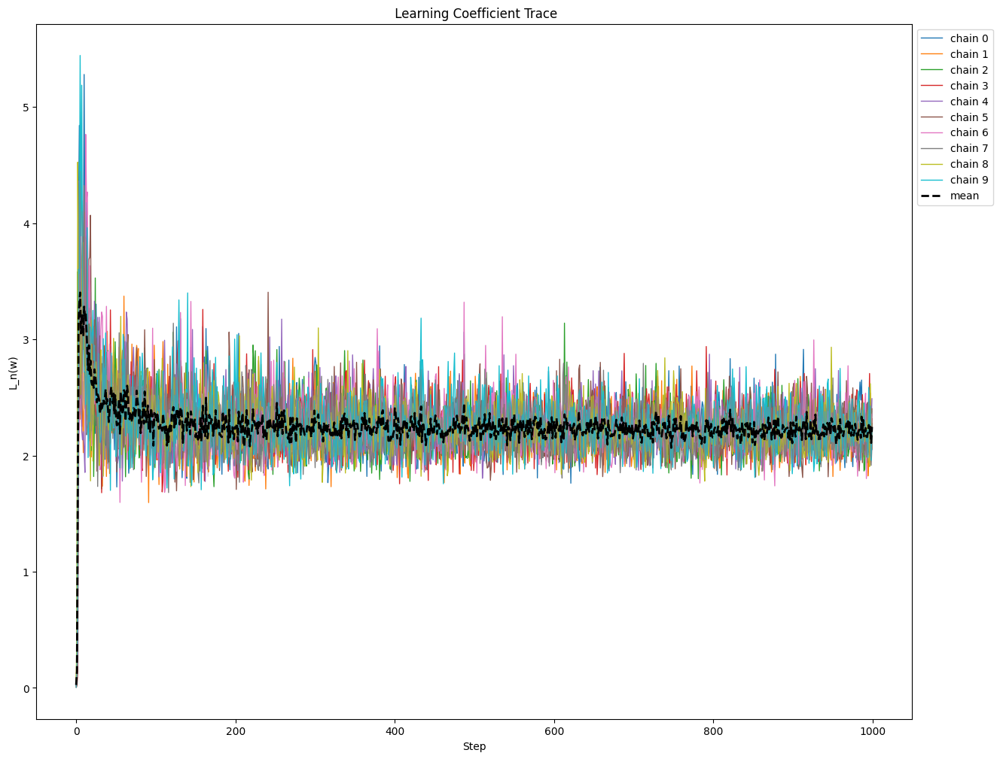

<Figure size 1200x900 with 0 Axes>

Chain 9: 100%|██████████| 1000/1000 [00:58<00:00, 17.20it/s]


Lambda hat estimates for adam_checkpoint600: 
llc-chain/0: 10492.7666015625
llc-chain/1: 10269.1357421875
llc-chain/2: 10423.404296875
llc-chain/3: 10356.013671875
llc-chain/4: 10325.00390625
llc-chain/5: 10312.48046875
llc-chain/6: 10290.169921875
llc-chain/7: 10341.705078125
llc-chain/8: 10404.693359375
llc-chain/9: 10425.322265625
llc/mean: 10364.0693359375
llc/std: 70.4841537475586



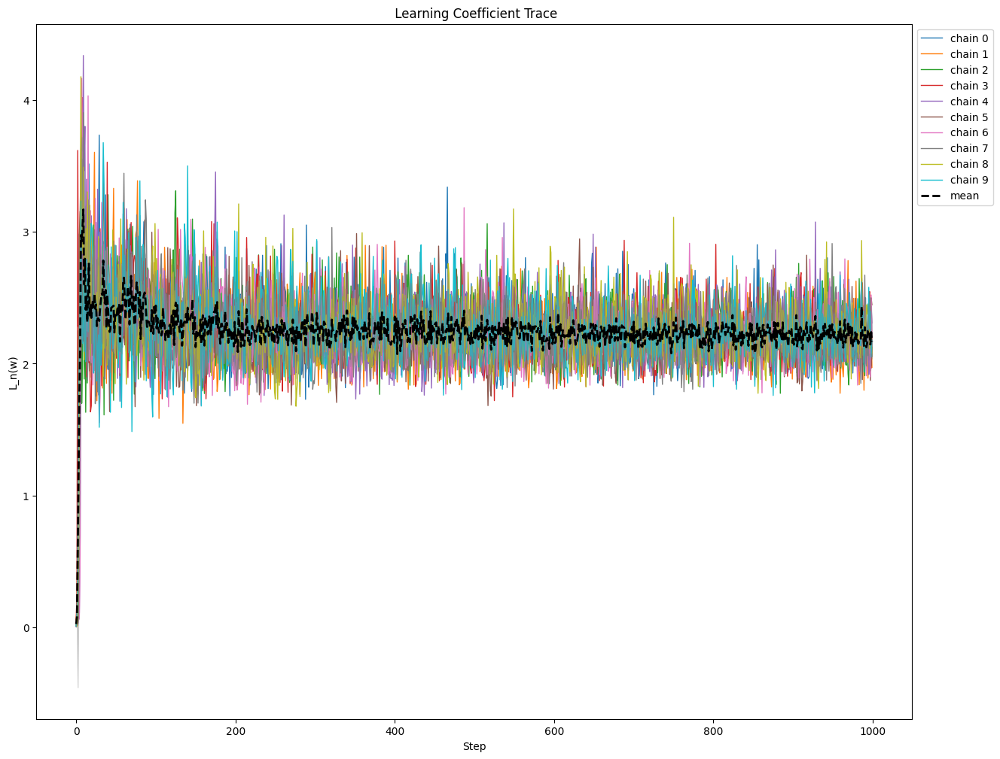

<Figure size 1200x900 with 0 Axes>

Chain 9: 100%|██████████| 1000/1000 [00:57<00:00, 17.52it/s]


Lambda hat estimates for adam_checkpoint700: 
llc-chain/0: 10318.7744140625
llc-chain/1: 10274.6494140625
llc-chain/2: 10390.677734375
llc-chain/3: 10302.5078125
llc-chain/4: 10327.5087890625
llc-chain/5: 10272.0576171875
llc-chain/6: 10318.111328125
llc-chain/7: 10339.806640625
llc-chain/8: 10305.369140625
llc-chain/9: 10343.8173828125
llc/mean: 10319.328125
llc/std: 34.780372619628906



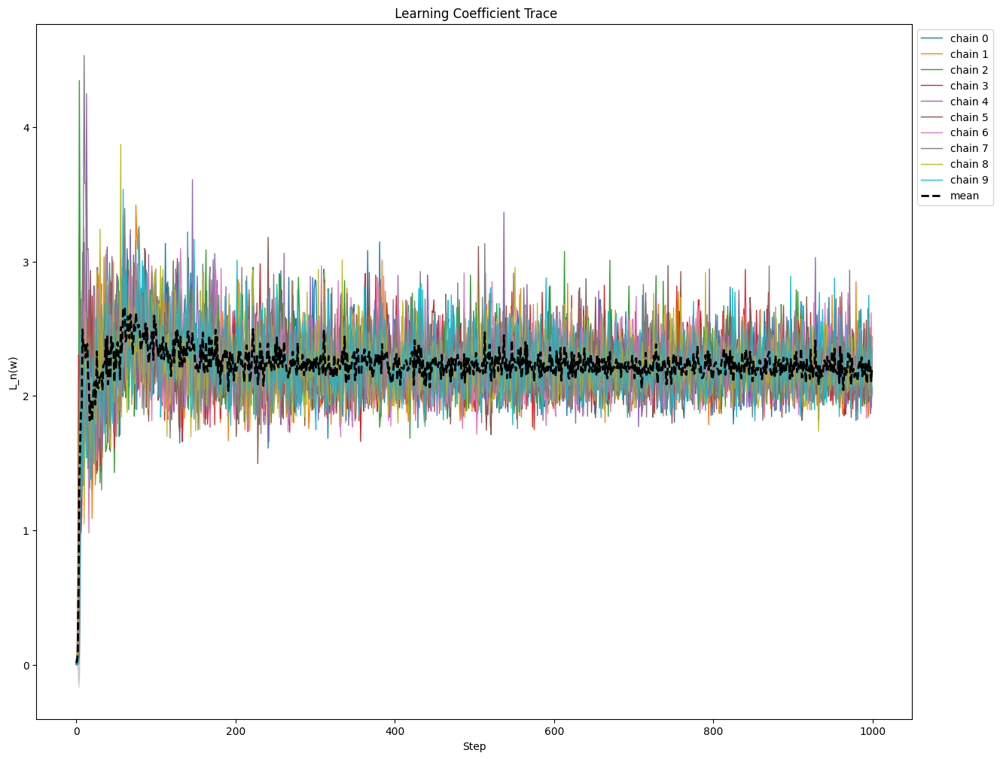

<Figure size 1200x900 with 0 Axes>

Chain 9: 100%|██████████| 1000/1000 [00:59<00:00, 16.89it/s]


Lambda hat estimates for adam_checkpoint800: 
llc-chain/0: 10224.220703125
llc-chain/1: 10152.4609375
llc-chain/2: 10163.6162109375
llc-chain/3: 10125.177734375
llc-chain/4: 10120.3310546875
llc-chain/5: 10049.310546875
llc-chain/6: 10088.8203125
llc-chain/7: 10012.87109375
llc-chain/8: 10208.408203125
llc-chain/9: 10304.5439453125
llc/mean: 10144.9755859375
llc/std: 86.23297119140625



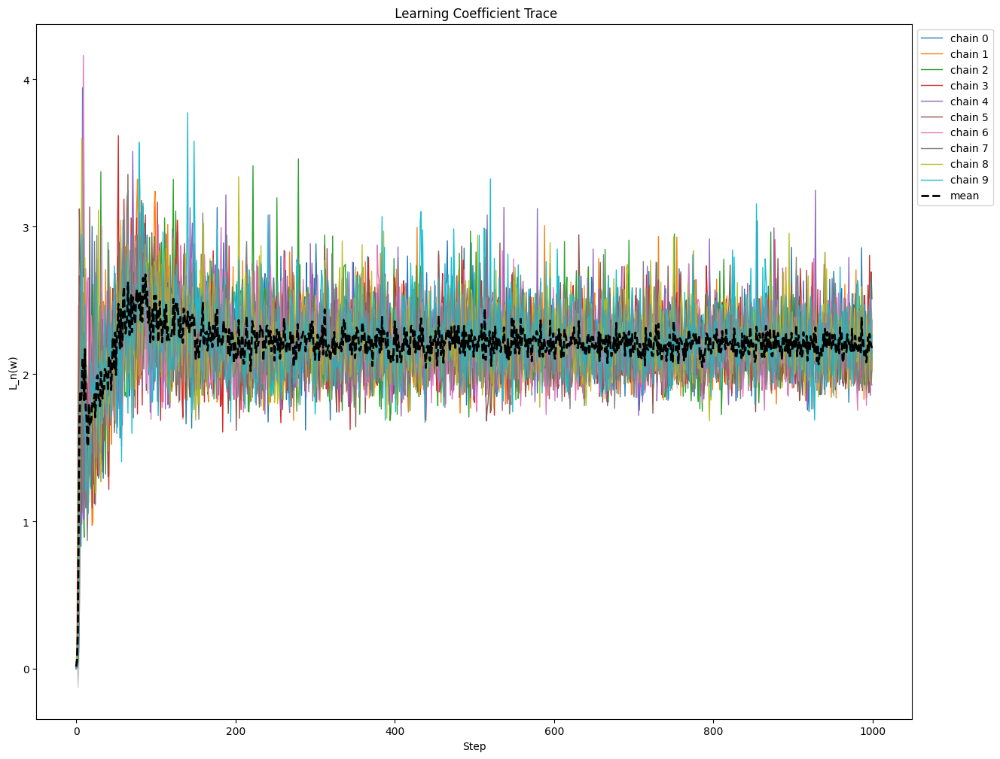

<Figure size 1200x900 with 0 Axes>

Chain 9: 100%|██████████| 1000/1000 [00:59<00:00, 16.70it/s]


Lambda hat estimates for adam_checkpoint900: 
llc-chain/0: 10007.3955078125
llc-chain/1: 10096.716796875
llc-chain/2: 10200.4453125
llc-chain/3: 10086.6884765625
llc-chain/4: 10113.3505859375
llc-chain/5: 10046.7880859375
llc-chain/6: 9982.8759765625
llc-chain/7: 10025.275390625
llc-chain/8: 10071.029296875
llc-chain/9: 10152.412109375
llc/mean: 10078.2978515625
llc/std: 66.70059204101562



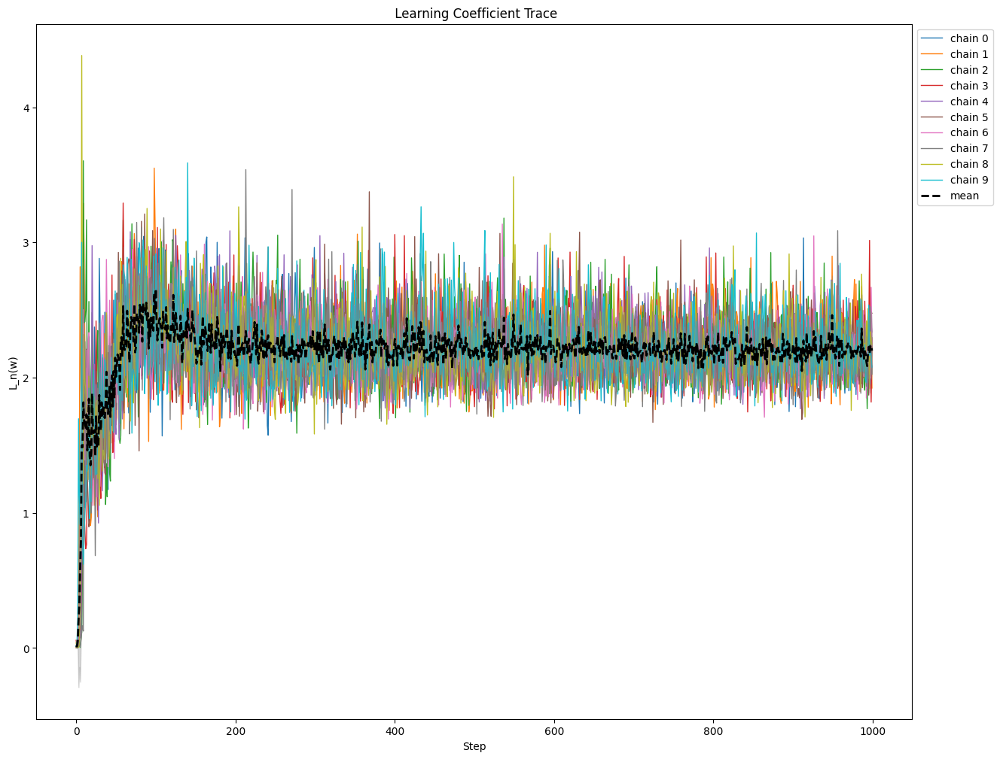

<Figure size 1200x900 with 0 Axes>

Chain 9: 100%|██████████| 1000/1000 [00:59<00:00, 16.75it/s]


Lambda hat estimates for adam_checkpoint1000: 
llc-chain/0: 10019.6884765625
llc-chain/1: 9955.2041015625
llc-chain/2: 9943.0478515625
llc-chain/3: 9968.7666015625
llc-chain/4: 9903.1064453125
llc-chain/5: 9885.8662109375
llc-chain/6: 9965.751953125
llc-chain/7: 9820.05078125
llc-chain/8: 9935.0810546875
llc-chain/9: 9966.9658203125
llc/mean: 9936.3525390625
llc/std: 55.155521392822266



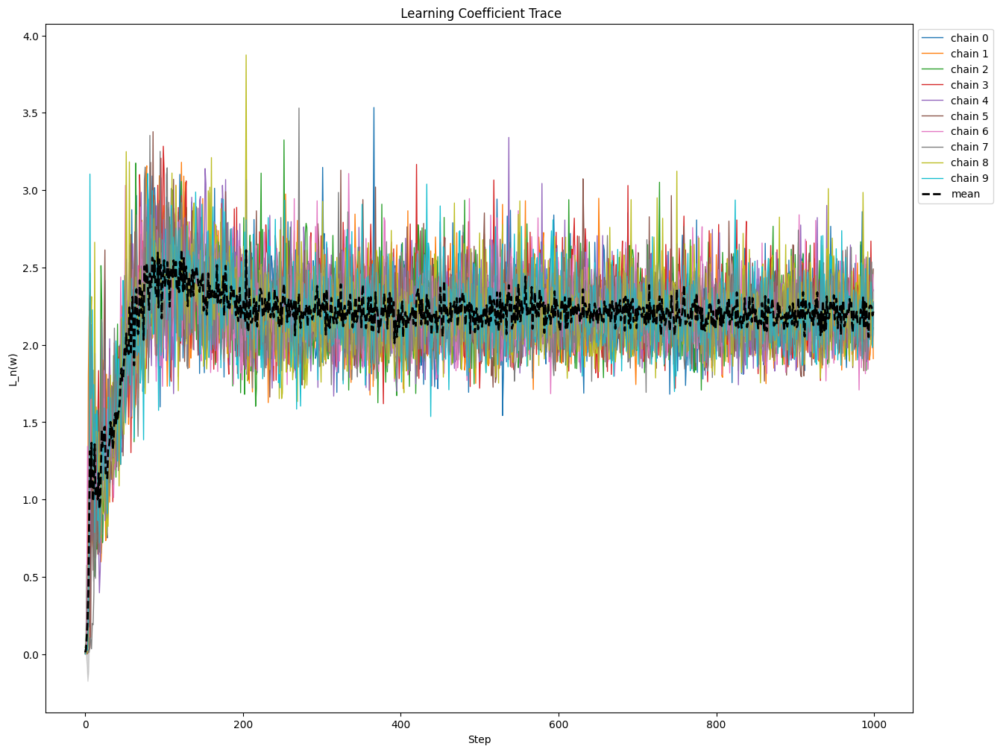

<Figure size 1200x900 with 0 Axes>

Chain 9: 100%|██████████| 1000/1000 [01:01<00:00, 16.20it/s]


Lambda hat estimates for adam_checkpoint1100: 
llc-chain/0: 9886.9736328125
llc-chain/1: 9924.7294921875
llc-chain/2: 9999.8955078125
llc-chain/3: 9958.375
llc-chain/4: 9857.6982421875
llc-chain/5: 9850.47265625
llc-chain/6: 9843.8984375
llc-chain/7: 9825.94921875
llc-chain/8: 9762.0302734375
llc-chain/9: 9922.4091796875
llc/mean: 9883.2431640625
llc/std: 69.73838806152344



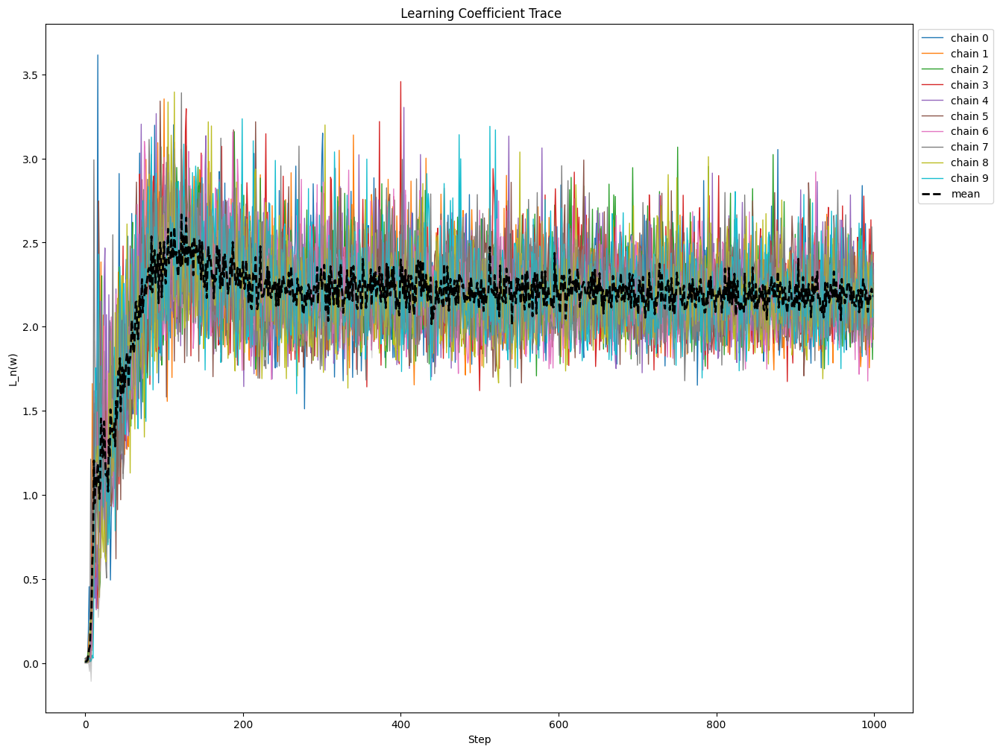

<Figure size 1200x900 with 0 Axes>

Chain 9: 100%|██████████| 1000/1000 [01:01<00:00, 16.22it/s]


Lambda hat estimates for adam_checkpoint1200: 
llc-chain/0: 9870.9541015625
llc-chain/1: 9997.666015625
llc-chain/2: 10123.369140625
llc-chain/3: 9848.1376953125
llc-chain/4: 9886.021484375
llc-chain/5: 9918.525390625
llc-chain/6: 9882.4365234375
llc-chain/7: 9842.9609375
llc-chain/8: 9863.060546875
llc-chain/9: 9996.23046875
llc/mean: 9922.9365234375
llc/std: 89.70956420898438



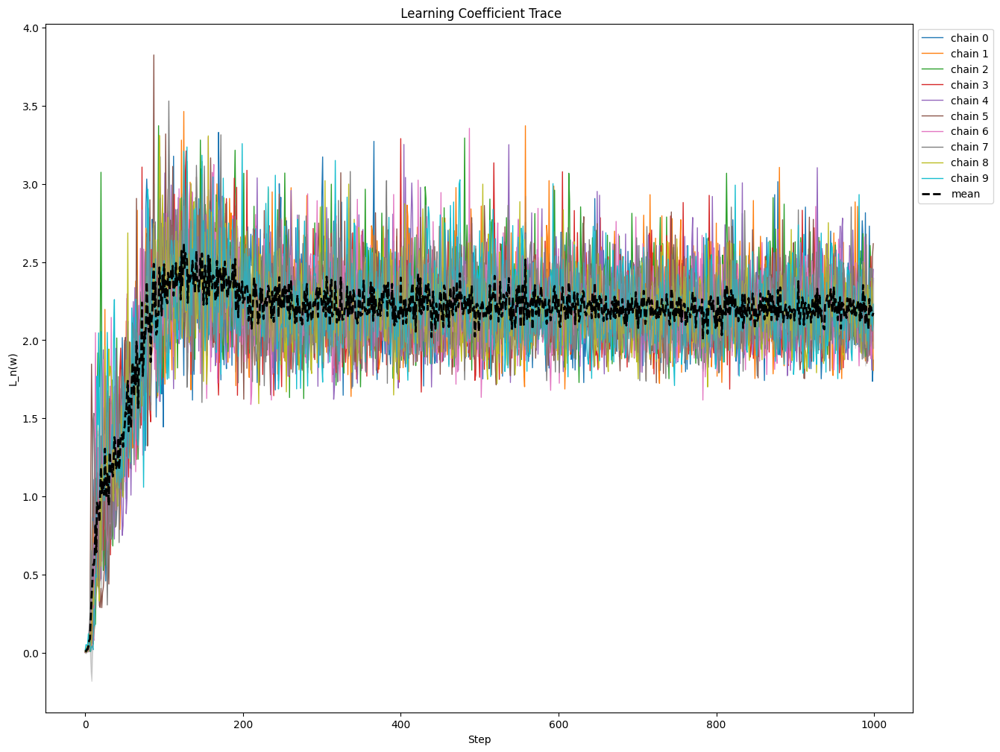

<Figure size 1200x900 with 0 Axes>

Chain 9: 100%|██████████| 1000/1000 [01:02<00:00, 16.01it/s]


Lambda hat estimates for adam_checkpoint1300: 
llc-chain/0: 9825.0625
llc-chain/1: 9894.81640625
llc-chain/2: 9857.69140625
llc-chain/3: 9872.2158203125
llc-chain/4: 9843.529296875
llc-chain/5: 9889.4453125
llc-chain/6: 9809.1572265625
llc-chain/7: 9779.015625
llc-chain/8: 9772.740234375
llc-chain/9: 9897.5654296875
llc/mean: 9844.1240234375
llc/std: 46.39701461791992



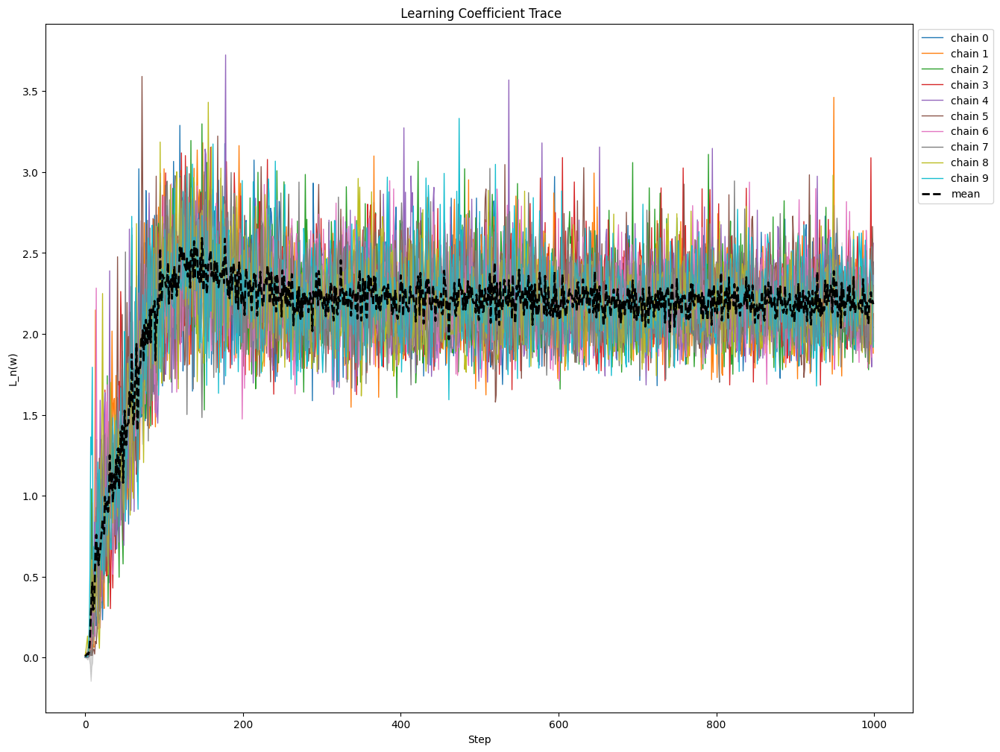

<Figure size 1200x900 with 0 Axes>

Chain 9: 100%|██████████| 1000/1000 [01:01<00:00, 16.30it/s]


Lambda hat estimates for adam_checkpoint1400: 
llc-chain/0: 9724.5078125
llc-chain/1: 9848.39453125
llc-chain/2: 9963.310546875
llc-chain/3: 9813.603515625
llc-chain/4: 9850.720703125
llc-chain/5: 9783.9609375
llc-chain/6: 9783.896484375
llc-chain/7: 9770.994140625
llc-chain/8: 9702.197265625
llc-chain/9: 9977.54296875
llc/mean: 9821.9130859375
llc/std: 91.35535430908203



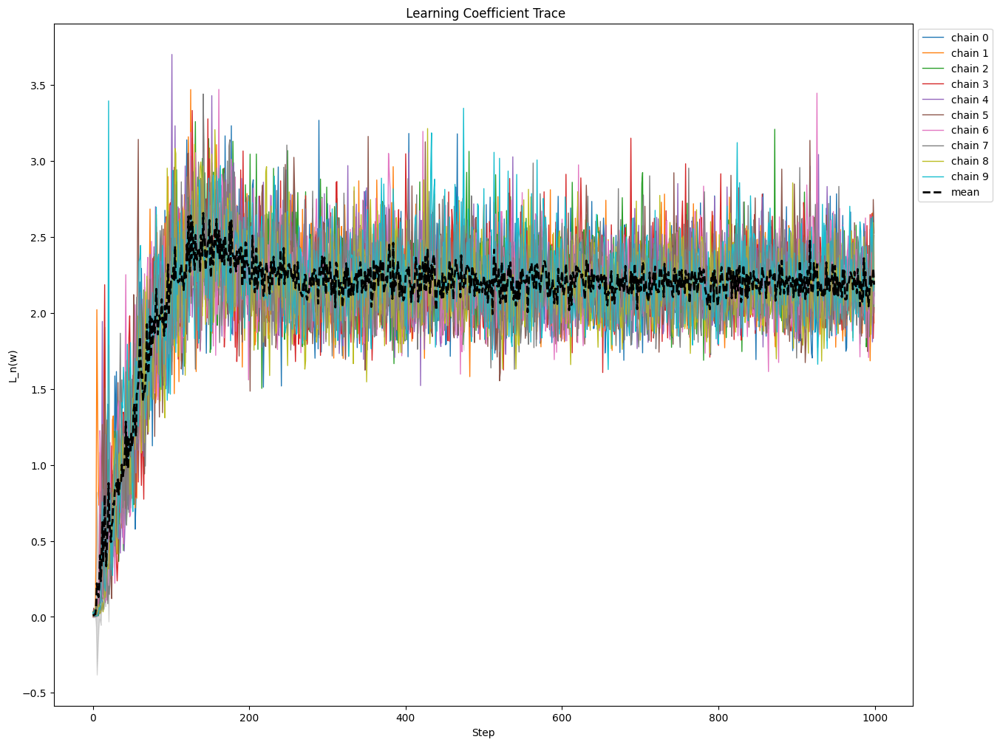

<Figure size 1200x900 with 0 Axes>

Chain 9: 100%|██████████| 1000/1000 [01:01<00:00, 16.18it/s]


Lambda hat estimates for adam_checkpoint1500: 
llc-chain/0: 9755.0869140625
llc-chain/1: 9883.1220703125
llc-chain/2: 9831.1875
llc-chain/3: 9750.8359375
llc-chain/4: 9734.603515625
llc-chain/5: 9779.6728515625
llc-chain/6: 9663.8388671875
llc-chain/7: 9795.720703125
llc-chain/8: 9707.7041015625
llc-chain/9: 9808.943359375
llc/mean: 9771.072265625
llc/std: 63.0648193359375



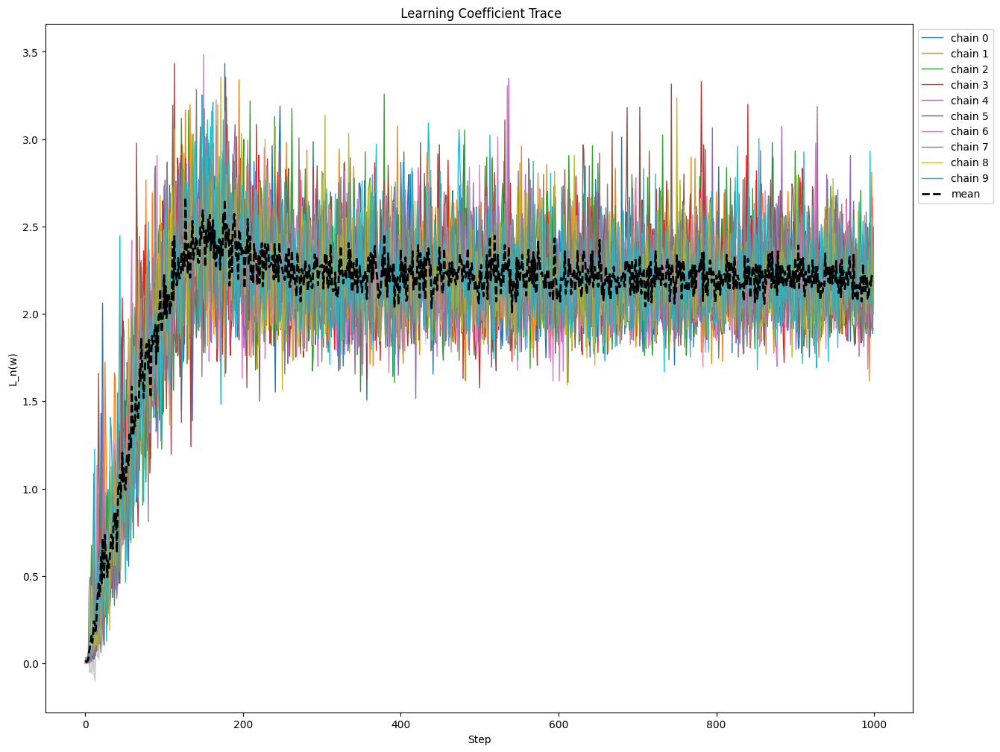

<Figure size 1200x900 with 0 Axes>

In [ ]:
indice_list = [10, 90] + list(range(100, 1600, 100))
studied_checkpoint = checkpoints_path + 'adam_checkpoint_with_noise'
name = 'sgd_checkpoint' if not use_adam_op else 'adam_checkpoint'

for i in indice_list:

      checkpoint_name = studied_checkpoint + str(i) + '.pth'
      right_name = name + str(i)
      checkpoint = torch.load(checkpoint_name, map_location = device)
      model.load_state_dict(checkpoint['model_state'])

      torch.manual_seed(0)
      checkpoint_rlcts = estimate_learning_coeff_with_summary(
          model,
          loader=trainloader,
          criterion=criterion,
          sampling_method=SGLD,
          optimizer_kwargs= optim_kwargs,
          num_chains=NUM_CHAINS,  # How many independent chains to run
          num_draws=NUM_DRAWS,  # How many samples to draw per chain
          num_burnin_steps=0,  # How many samples to discard at the beginning of each chain
          num_steps_bw_draws=1,  # How many steps to take between each sample
          device=device,
          )

      current_checkpoint = rlcts_path + 'no_burnin_'+ right_name + '_rlcts.pt' if not use_label_noise else rlcts_path + 'no_burnin_' + right_name + '_with_noise' + '_rlcts.pt'
      torch.save(checkpoint_rlcts, current_checkpoint)

      #all_results.append(checkpoint_rlcts)

      trace = checkpoint_rlcts.pop("loss/trace")

      print(f"Lambda hat estimates for {right_name}: ")
      print(yaml.dump(checkpoint_rlcts))
      plot_trace(trace, 'L_n(w)', x_axis='Step', title=' Learning Coefficient Trace', plot_mean=False, plot_std=False, fig_size=(12, 9), true_lc = None)
      plt.show()

In [ ]:
concerned = list(range(20, 100, 10))
concerned.remove(90)
concerned

[20, 30, 40, 50, 60, 70, 80]

Chain 9: 100%|██████████| 1000/1000 [00:50<00:00, 19.81it/s]


Lambda hat estimates for adam_checkpoint20: 
llc-chain/0: 5539.81494140625
llc-chain/1: 5619.77197265625
llc-chain/2: 5601.32373046875
llc-chain/3: 5763.90673828125
llc-chain/4: 5569.5244140625
llc-chain/5: 5839.884765625
llc-chain/6: 5499.10009765625
llc-chain/7: 5933.384765625
llc-chain/8: 5697.6298828125
llc-chain/9: 5713.93017578125
llc/mean: 5677.82763671875
llc/std: 138.4922637939453



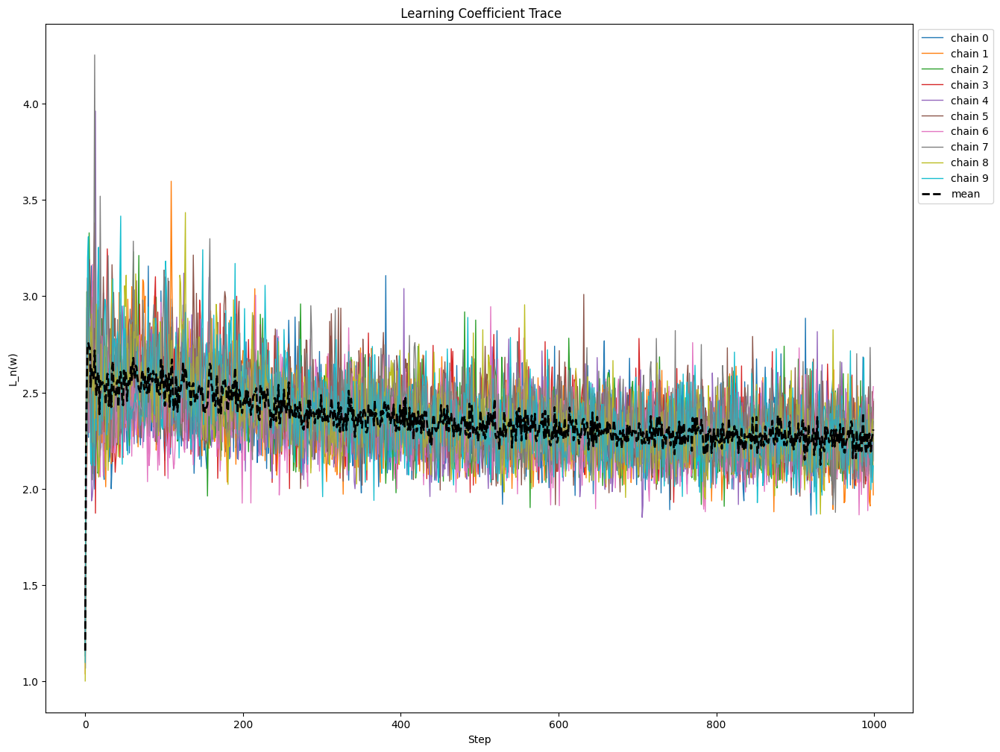

<Figure size 1200x900 with 0 Axes>

Chain 9: 100%|██████████| 1000/1000 [00:50<00:00, 19.88it/s]


Lambda hat estimates for adam_checkpoint30: 
llc-chain/0: 6165.2392578125
llc-chain/1: 6283.66748046875
llc-chain/2: 6232.79345703125
llc-chain/3: 6176.134765625
llc-chain/4: 6257.78173828125
llc-chain/5: 6248.30517578125
llc-chain/6: 6268.8896484375
llc-chain/7: 6339.54296875
llc-chain/8: 6490.47265625
llc-chain/9: 6371.4228515625
llc/mean: 6283.4248046875
llc/std: 96.55538177490234



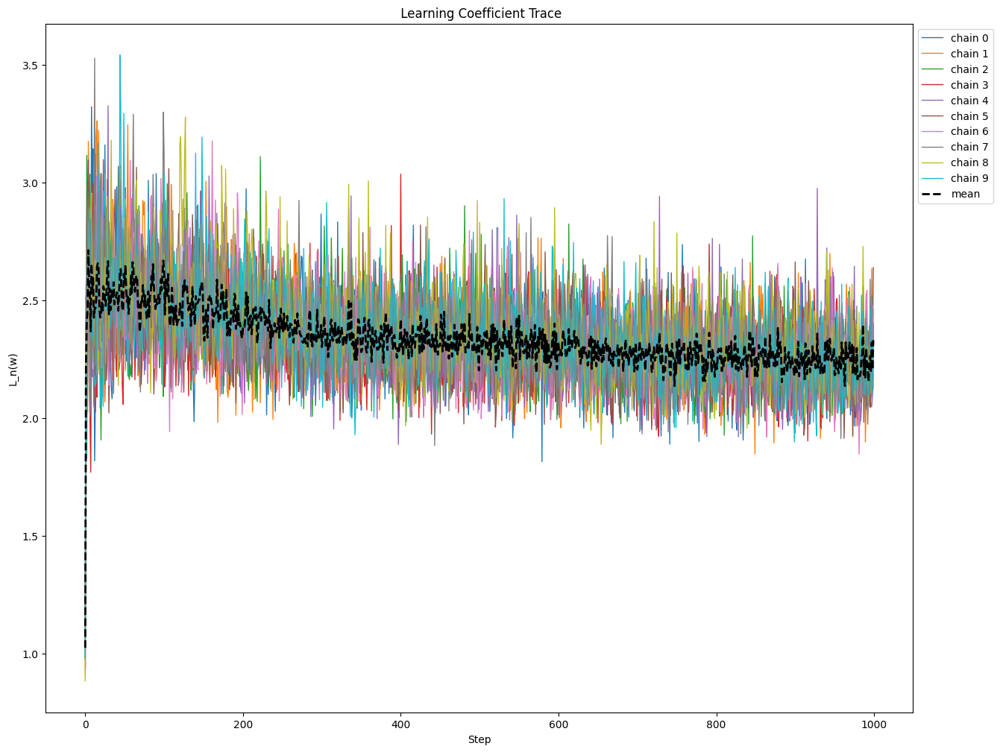

<Figure size 1200x900 with 0 Axes>

Chain 9: 100%|██████████| 1000/1000 [00:53<00:00, 18.71it/s]


Lambda hat estimates for adam_checkpoint40: 
llc-chain/0: 6761.3544921875
llc-chain/1: 6701.92626953125
llc-chain/2: 6704.82958984375
llc-chain/3: 6742.88037109375
llc-chain/4: 6709.94287109375
llc-chain/5: 6724.37158203125
llc-chain/6: 6968.3359375
llc-chain/7: 6982.087890625
llc-chain/8: 6900.98779296875
llc-chain/9: 6918.6337890625
llc/mean: 6811.53515625
llc/std: 116.28355407714844



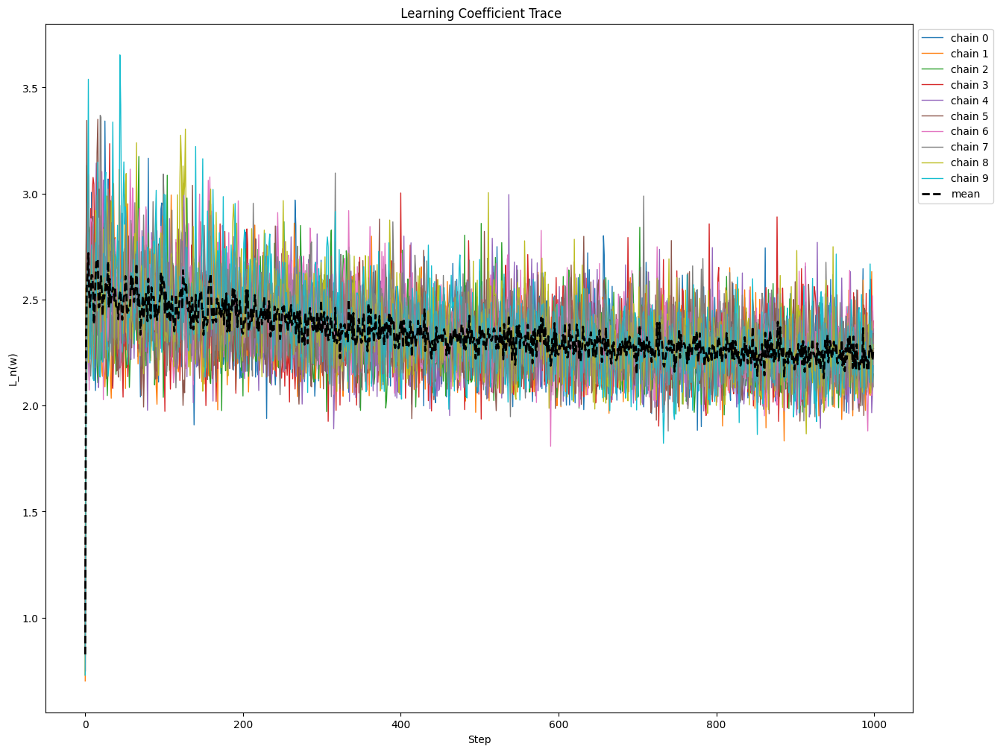

<Figure size 1200x900 with 0 Axes>

Chain 9: 100%|██████████| 1000/1000 [00:52<00:00, 19.14it/s]


Lambda hat estimates for adam_checkpoint50: 
llc-chain/0: 7197.95458984375
llc-chain/1: 7176.04541015625
llc-chain/2: 7307.4462890625
llc-chain/3: 7207.2509765625
llc-chain/4: 7402.05126953125
llc-chain/5: 7380.0244140625
llc-chain/6: 7380.58544921875
llc-chain/7: 7411.96142578125
llc-chain/8: 7343.8916015625
llc-chain/9: 7368.16064453125
llc/mean: 7317.53759765625
llc/std: 90.54188537597656



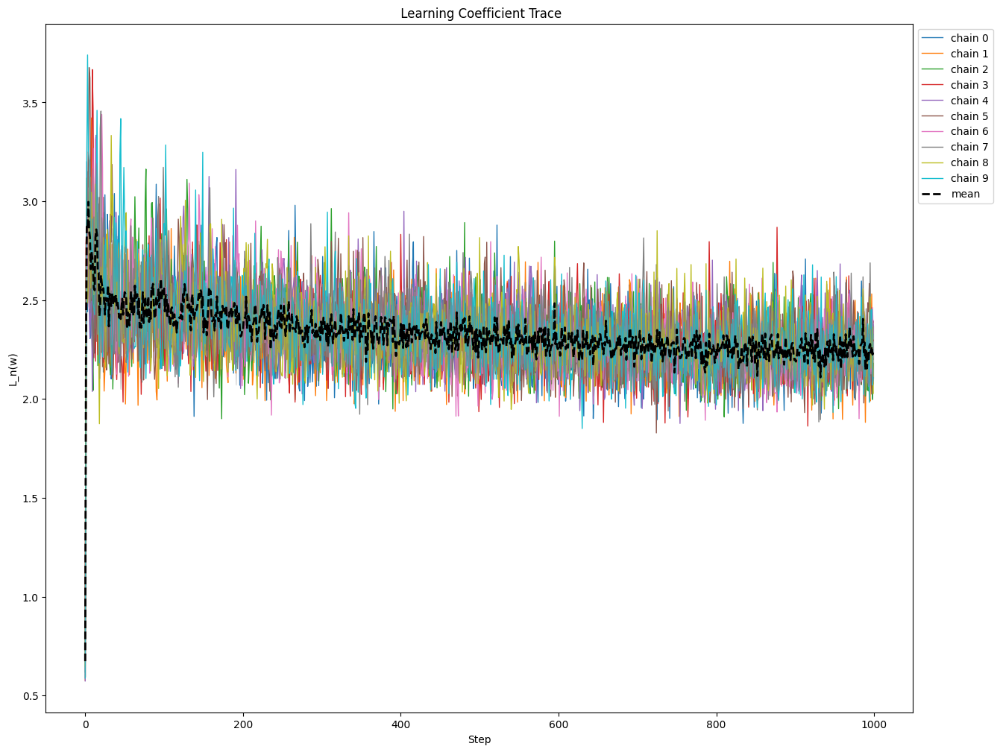

<Figure size 1200x900 with 0 Axes>

Chain 9: 100%|██████████| 1000/1000 [00:55<00:00, 17.91it/s]


Lambda hat estimates for adam_checkpoint60: 
llc-chain/0: 7559.18017578125
llc-chain/1: 7654.90771484375
llc-chain/2: 7686.16845703125
llc-chain/3: 7594.37646484375
llc-chain/4: 7595.12548828125
llc-chain/5: 7743.70068359375
llc-chain/6: 7703.95654296875
llc-chain/7: 7522.16845703125
llc-chain/8: 7607.60986328125
llc-chain/9: 7966.96044921875
llc/mean: 7663.41552734375
llc/std: 126.56962585449219



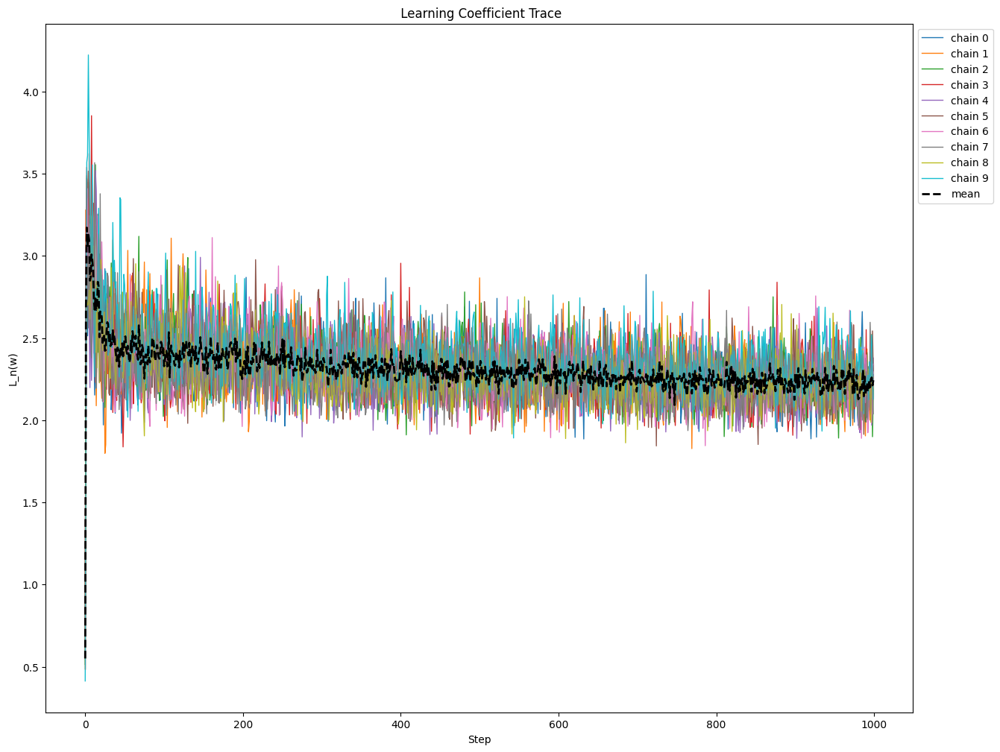

<Figure size 1200x900 with 0 Axes>

Chain 9: 100%|██████████| 1000/1000 [00:56<00:00, 17.68it/s]


Lambda hat estimates for adam_checkpoint70: 
llc-chain/0: 8107.841796875
llc-chain/1: 8190.32470703125
llc-chain/2: 8036.1396484375
llc-chain/3: 8005.541015625
llc-chain/4: 8155.9375
llc-chain/5: 8255.521484375
llc-chain/6: 8096.15283203125
llc-chain/7: 8194.2919921875
llc-chain/8: 8017.234375
llc-chain/9: 8178.67138671875
llc/mean: 8123.765625
llc/std: 84.87491607666016



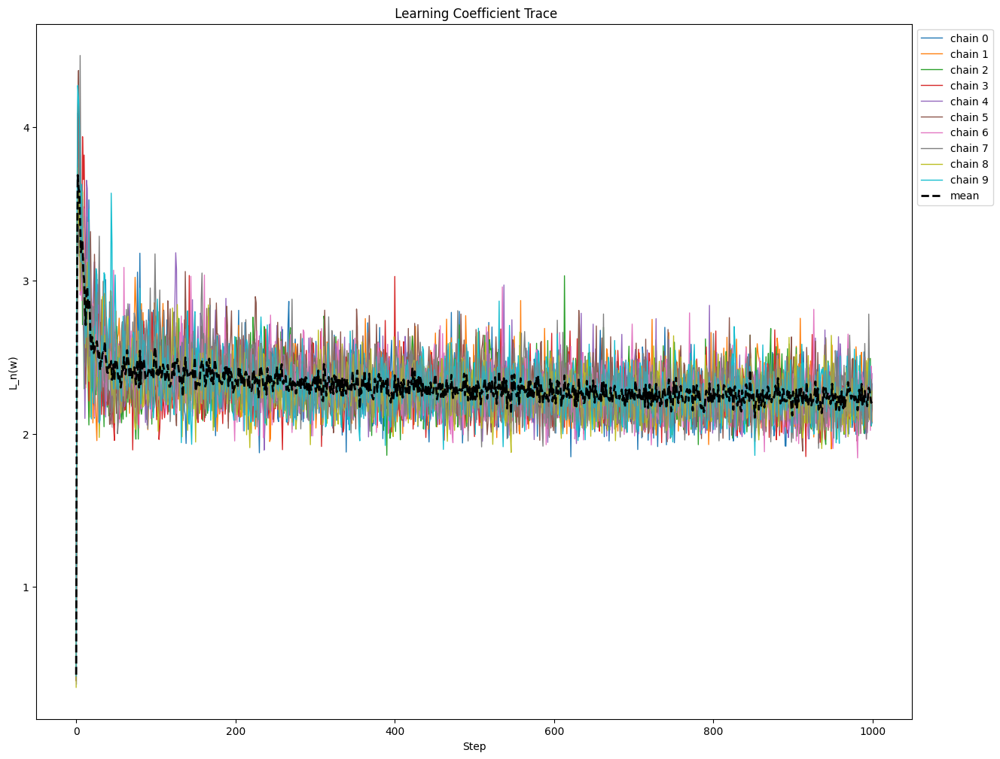

<Figure size 1200x900 with 0 Axes>

Chain 9: 100%|██████████| 1000/1000 [00:57<00:00, 17.27it/s]


Lambda hat estimates for adam_checkpoint80: 
llc-chain/0: 8967.984375
llc-chain/1: 8912.634765625
llc-chain/2: 9029.650390625
llc-chain/3: 8905.958984375
llc-chain/4: 9106.5888671875
llc-chain/5: 9254.3427734375
llc-chain/6: 8970.8232421875
llc-chain/7: 8948.5283203125
llc-chain/8: 8973.0888671875
llc-chain/9: 8993.7216796875
llc/mean: 9006.33203125
llc/std: 104.50679016113281



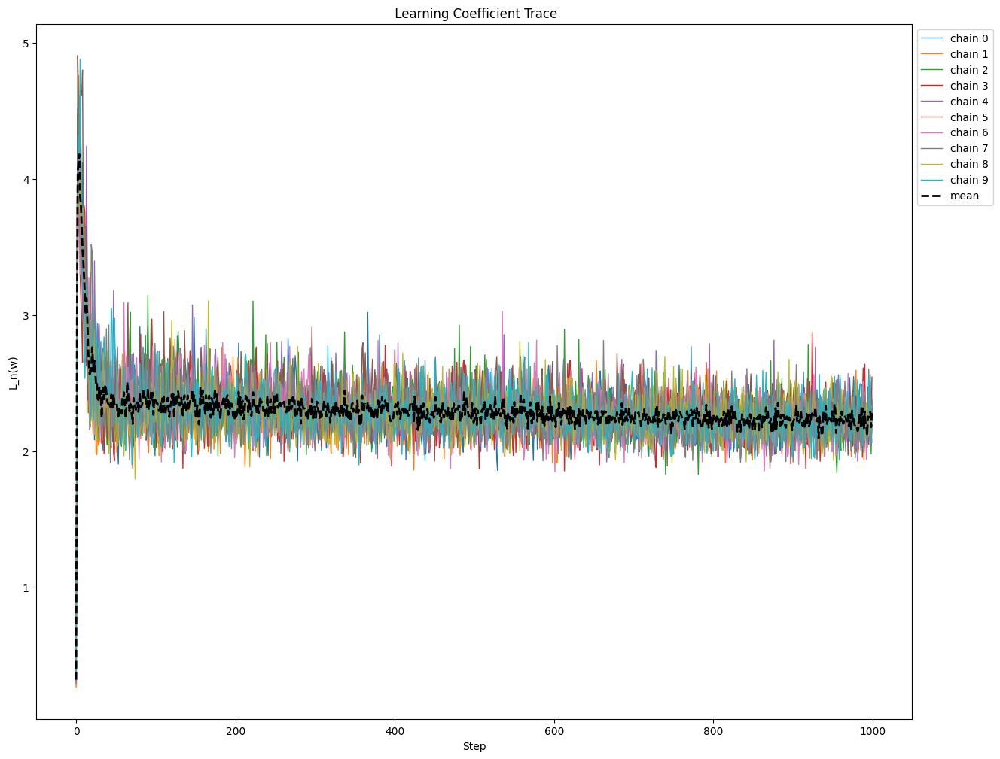

<Figure size 1200x900 with 0 Axes>

In [ ]:
per_checkpoint = checkpoints_per_path + 'adam_checkpoint_with_noise'
name = 'sgd_checkpoint' if not use_adam_op else 'adam_checkpoint'


for i in range(len(concerned)):

      checkpoint_name = per_checkpoint + str(concerned[i]) + '.pth'
      right_name = name + str(concerned[i])
      checkpoint = torch.load(checkpoint_name, map_location = device)
      model.load_state_dict(checkpoint['model_state'])

      torch.manual_seed(0)
      checkpoint_rlcts = estimate_learning_coeff_with_summary(
          model,
          loader=trainloader,
          criterion=criterion,
          sampling_method=SGLD,
          optimizer_kwargs= optim_kwargs,
          num_chains=NUM_CHAINS,  # How many independent chains to run
          num_draws=NUM_DRAWS,  # How many samples to draw per chain
          num_burnin_steps=0,  # How many samples to discard at the beginning of each chain
          num_steps_bw_draws=1,  # How many steps to take between each sample
          device=device,
          )

      current_checkpoint = rlcts_path + 'no_burnin_'+ right_name + '_rlcts.pt' if not use_label_noise else rlcts_path + 'no_burnin_' + right_name + '_with_noise' + '_rlcts.pt'
      torch.save(checkpoint_rlcts, current_checkpoint)

      #all_results.append(checkpoint_rlcts)

      trace = checkpoint_rlcts.pop("loss/trace")

      print(f"Lambda hat estimates for {right_name}: ")
      print(yaml.dump(checkpoint_rlcts))
      plot_trace(trace, 'L_n(w)', x_axis='Step', title=' Learning Coefficient Trace', plot_mean=False, plot_std=False, fig_size=(12, 9), true_lc = None)
      plt.show()


In [ ]:
epochs = concerned + indice_list
epochs.sort()
epochs

[10,
 20,
 30,
 40,
 50,
 60,
 70,
 80,
 90,
 100,
 200,
 300,
 400,
 500,
 600,
 700,
 800,
 900,
 1000,
 1100,
 1200,
 1300,
 1400,
 1500]

In [ ]:
ch_names = []
for i in epochs:
  name_checkpoint_rclts = rlcts_path + 'no_burnin_' + name + str(i) + '_rlcts.pt' if not use_label_noise else rlcts_path + 'no_burnin_' + name + str(i) + '_with_noise' + '_rlcts.pt'
  ch_names.append(name_checkpoint_rclts)

In [ ]:
ch_names

['/content/gdrive/My Drive/checkpoints/rlcts/no_burnin_adam_checkpoint10_with_noise_rlcts.pt',
 '/content/gdrive/My Drive/checkpoints/rlcts/no_burnin_adam_checkpoint20_with_noise_rlcts.pt',
 '/content/gdrive/My Drive/checkpoints/rlcts/no_burnin_adam_checkpoint30_with_noise_rlcts.pt',
 '/content/gdrive/My Drive/checkpoints/rlcts/no_burnin_adam_checkpoint40_with_noise_rlcts.pt',
 '/content/gdrive/My Drive/checkpoints/rlcts/no_burnin_adam_checkpoint50_with_noise_rlcts.pt',
 '/content/gdrive/My Drive/checkpoints/rlcts/no_burnin_adam_checkpoint60_with_noise_rlcts.pt',
 '/content/gdrive/My Drive/checkpoints/rlcts/no_burnin_adam_checkpoint70_with_noise_rlcts.pt',
 '/content/gdrive/My Drive/checkpoints/rlcts/no_burnin_adam_checkpoint80_with_noise_rlcts.pt',
 '/content/gdrive/My Drive/checkpoints/rlcts/no_burnin_adam_checkpoint90_with_noise_rlcts.pt',
 '/content/gdrive/My Drive/checkpoints/rlcts/no_burnin_adam_checkpoint100_with_noise_rlcts.pt',
 '/content/gdrive/My Drive/checkpoints/rlcts/no_b

In [ ]:
all_rlcts = []
for i in range (len(ch_names)):
  checkpoint_rlcts = torch.load(ch_names[i])
  all_rlcts.append(checkpoint_rlcts['llc/mean'])

In [ ]:
all_rlcts

[5102.2783203125,
 5677.82763671875,
 6283.4248046875,
 6811.53515625,
 7317.53759765625,
 7663.41552734375,
 8123.765625,
 9006.33203125,
 9077.578125,
 9564.904296875,
 9783.3037109375,
 10116.53515625,
 10154.5244140625,
 10343.41015625,
 10364.0693359375,
 10319.328125,
 10144.9755859375,
 10078.2978515625,
 9936.3525390625,
 9883.2431640625,
 9922.9365234375,
 9844.1240234375,
 9821.9130859375,
 9771.072265625]

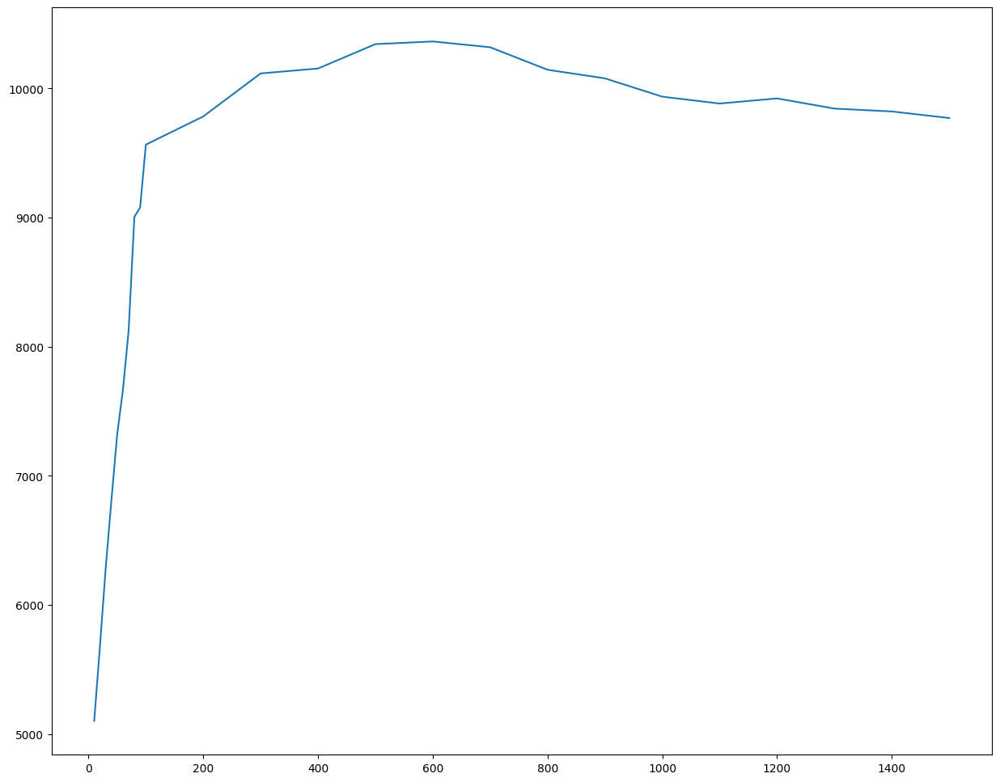

In [ ]:
plt.plot(epochs, all_rlcts)
#plt.xscale('log')
plt.show()

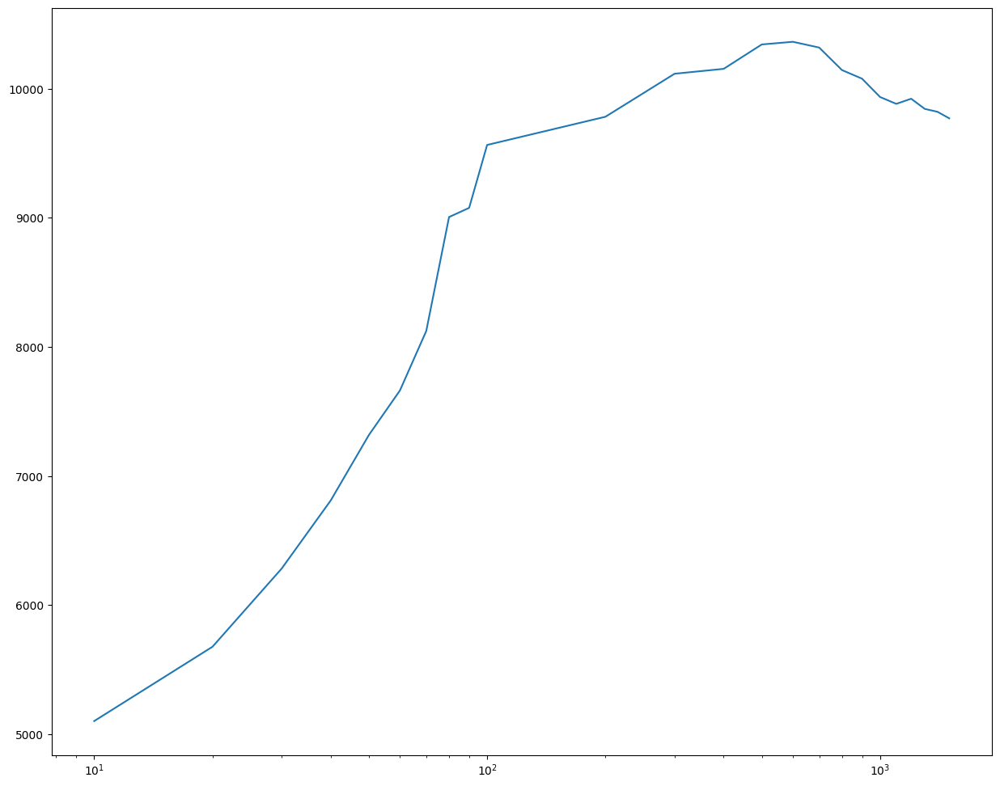

In [ ]:
plt.plot(epochs, all_rlcts)
plt.xscale('log')
plt.show()

In [ ]:
init_names = []
for i in indice_list:
  n_checkpoint_rclts = rlcts_path + 'no_burnin_' + name + str(i) + '_rlcts.pt' if not use_label_noise else rlcts_path + 'no_burnin_' + name + str(i) + '_with_noise' + '_rlcts.pt'
  init_names.append(n_checkpoint_rclts)

In [ ]:
init_results = []
for i in range(len(init_names)):
  llc = torch.load(init_names[i])
  init_results.append(llc['llc/mean'])

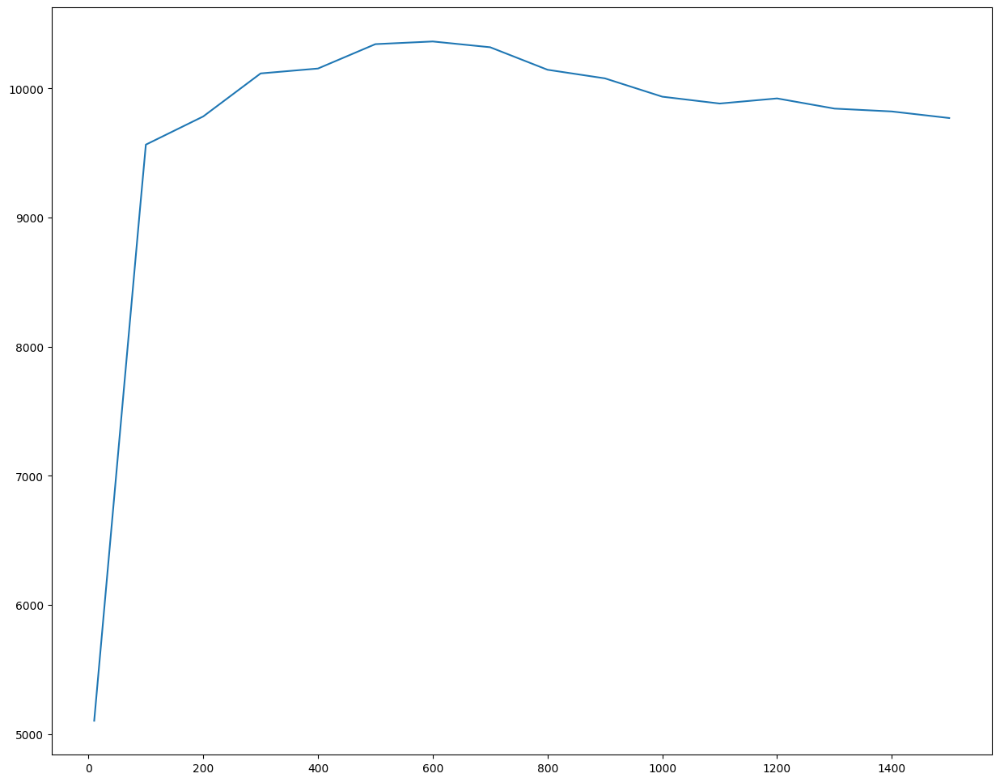

In [ ]:
plt.plot(indice_list, init_results)
#plt.xscale('log')
plt.show()

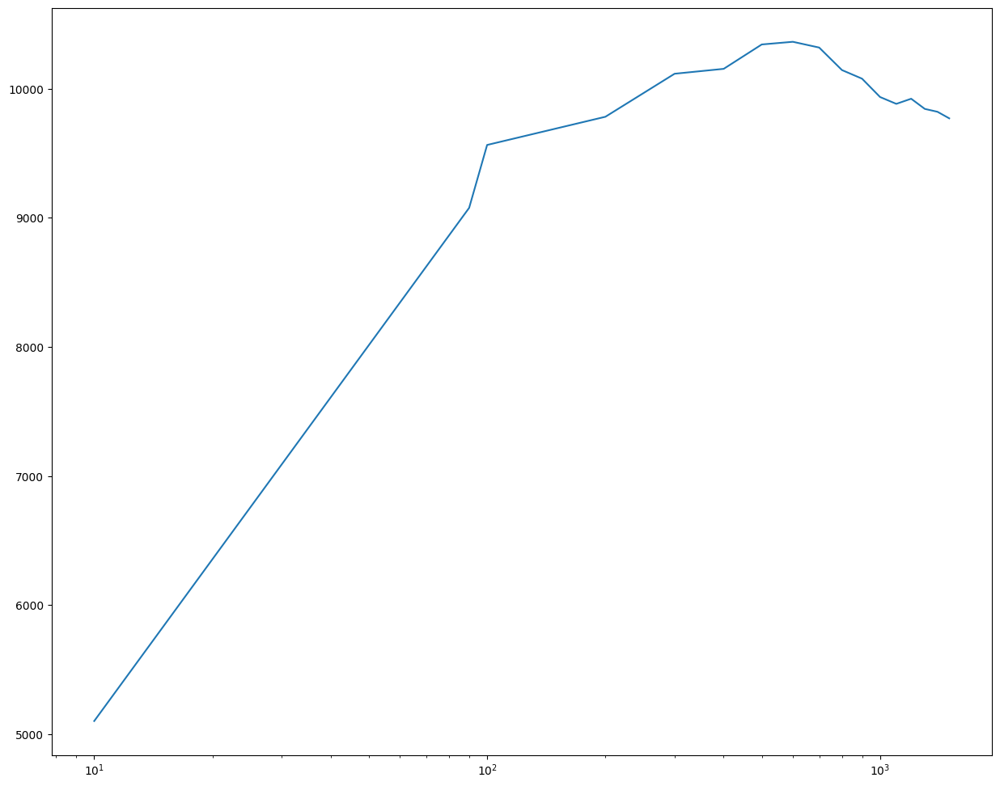

In [ ]:
plt.plot(indice_list, init_results)
plt.xscale('log')
plt.show()